# NeuroMANCER dynamical systems, system identification


## NeuroMANCER and Dependencies

### Install (Colab only)
Skip this step when running locally.

In [ ]:
!pip install "neuromancer[examples] @ git+https://github.com/pnnl/neuromancer.git@master"

# Input signals in neuromancer.psl

For a system identification task, a sequences of input signals must be generated in order to perturb the system across the dyanmic range of the state space. Neuromancer.psl has functions to generate all the standard perturbations used in system identification including:

+ Random walk: walk
+ White noise: noise
+ Random step functions: step
+ Randomly offset periodic functions (sin, cos, square, sawtooth): periodic
+ Sum of sines: sines
+ Auto-regressive moving average: arma
+ Cubic spline interpolation between randomly sampled points: splines

All input signal generator functions have the arguments: 

+ nsim: Length of input signal time series
+ d: Dimension of input signal time series
+ min: Minimum value for input signal time series
+ max: Maximum value for input signal time series

All signals are by default scaled to between min and max, however the unbounded signals white noise, random walk, and ARMA
have a bounded argument which can be set to false if an unbounded signal is desired. 

Below are plots of each signal time series generated with nsim=1000 and d=3.

In [1]:
from neuromancer.psl.signals import signals
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
signals

{'sin': functools.partial(<function periodic at 0x0000015F8EBB1900>, form='sin'),
 'square': functools.partial(<function periodic at 0x0000015F8EBB1900>, form='square'),
 'sawtooth': functools.partial(<function periodic at 0x0000015F8EBB1900>, form='sawtooth'),
 'walk': <function neuromancer.psl.signals.walk(nsim, d, min=0.0, max=1.0, sigma=0.05, bound=True, rng=Generator(PCG64) at 0x15F8EBAC3C0)>,
 'noise': <function neuromancer.psl.signals.noise(nsim, d, min=0.0, max=1.0, sigma=0.05, bound=True, rng=Generator(PCG64) at 0x15F8EBAC4A0)>,
 'step': <function neuromancer.psl.signals.step(nsim, d, min=0.0, max=1.0, randsteps=30, values=None, rng=Generator(PCG64) at 0x15F8EBAC580)>,
 'spline': <function neuromancer.psl.signals.spline(nsim, d, min=0.0, max=1.0, values=None, n_interpolants=30, rng=Generator(PCG64) at 0x15F8EBAC820)>,
 'sines': <function neuromancer.psl.signals.sines(nsim, d, min=0.0, max=1.0, periods=30, nwaves=20, form='sin', rng=Generator(PCG64) at 0x15F8EBAC740)>,
 'arma':

sin (1000, 3)


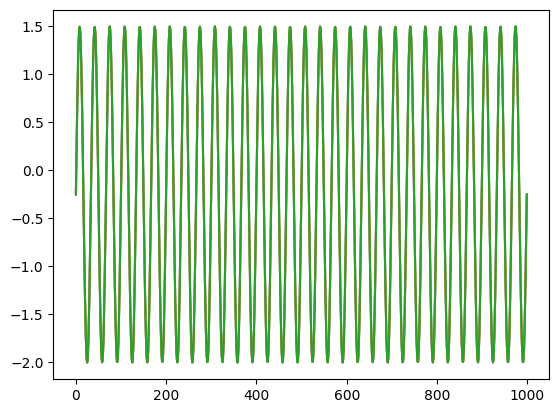

square (1000, 3)


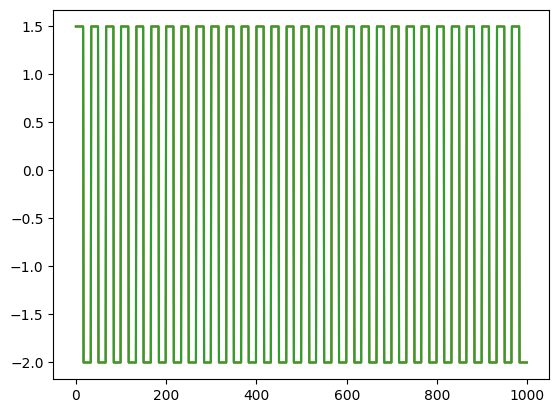

sawtooth (1000, 3)


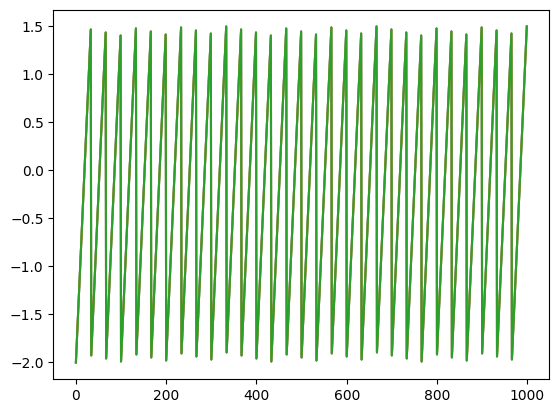

walk (1000, 3)


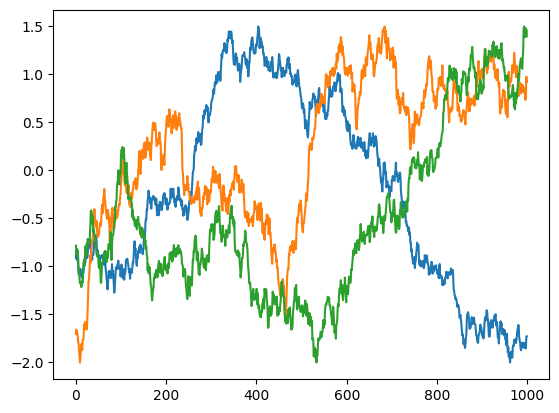

noise (1000, 3)


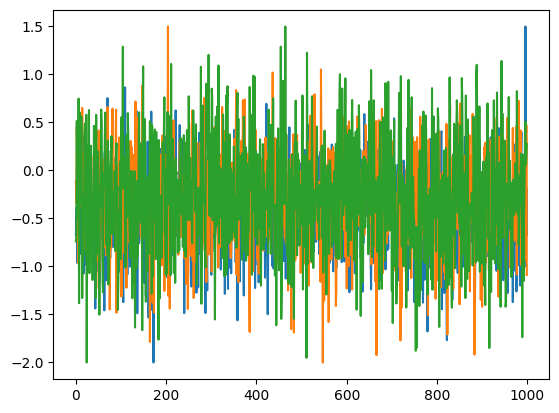

step (1000, 3)


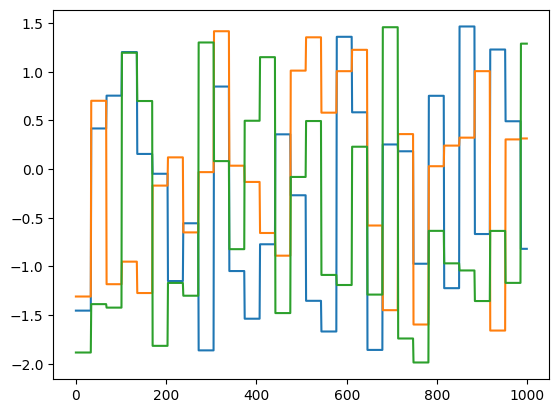

spline (1000, 3)


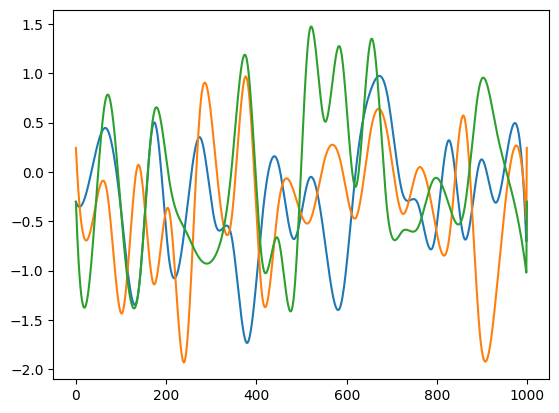

sines (1000, 3)


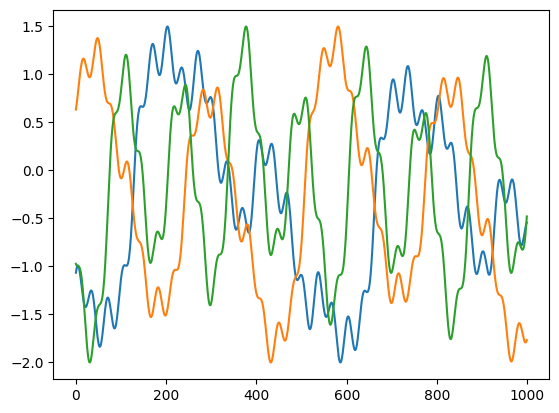

arma (1000, 3)


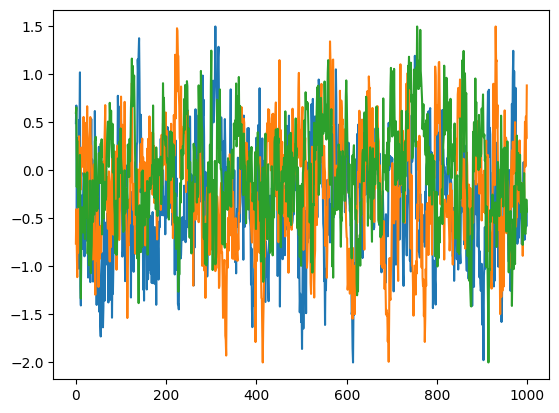

prbs (1000, 3)


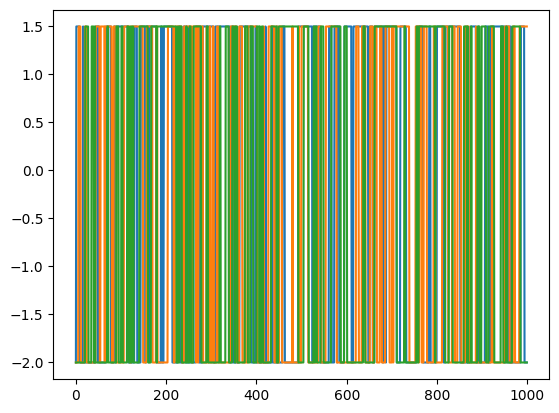

In [3]:
for n, s in signals.items():
    x = s(1000, 3, min=-2., max=1.5)
    print(n, x.shape)
    plt.plot(x)
    plt.show()
    plt.close()

# Systems in NM's Python Systems Library (psl)

The psl subpackage provides systems models for a range of autonomous, nonautonomous, networked, and building envelope systems, as well as an interface for loading and interacting with pre-recorded measurement datasets in common with the systems models. 

In [4]:
import neuromancer
neuromancer.psl.systems

{'Autoignition': neuromancer.psl.autonomous.Autoignition,
 'Brusselator1D': neuromancer.psl.autonomous.Brusselator1D,
 'ChuaCircuit': neuromancer.psl.autonomous.ChuaCircuit,
 'DoublePendulum': neuromancer.psl.autonomous.DoublePendulum,
 'Duffing': neuromancer.psl.autonomous.Duffing,
 'LorenzSystem': neuromancer.psl.autonomous.LorenzSystem,
 'LotkaVolterra': neuromancer.psl.autonomous.LotkaVolterra,
 'Pendulum': neuromancer.psl.autonomous.Pendulum,
 'RosslerAttractor': neuromancer.psl.autonomous.RosslerAttractor,
 'ThomasAttractor': neuromancer.psl.autonomous.ThomasAttractor,
 'UniversalOscillator': neuromancer.psl.autonomous.UniversalOscillator,
 'VanDerPol': neuromancer.psl.autonomous.VanDerPol,
 'Actuator': neuromancer.psl.nonautonomous.Actuator,
 'CSTR': neuromancer.psl.nonautonomous.CSTR,
 'DuffingControl': neuromancer.psl.nonautonomous.DuffingControl,
 'HindmarshRose': neuromancer.psl.nonautonomous.HindmarshRose,
 'InvPendulum': neuromancer.psl.nonautonomous.InvPendulum,
 'IverSim

Autoignition


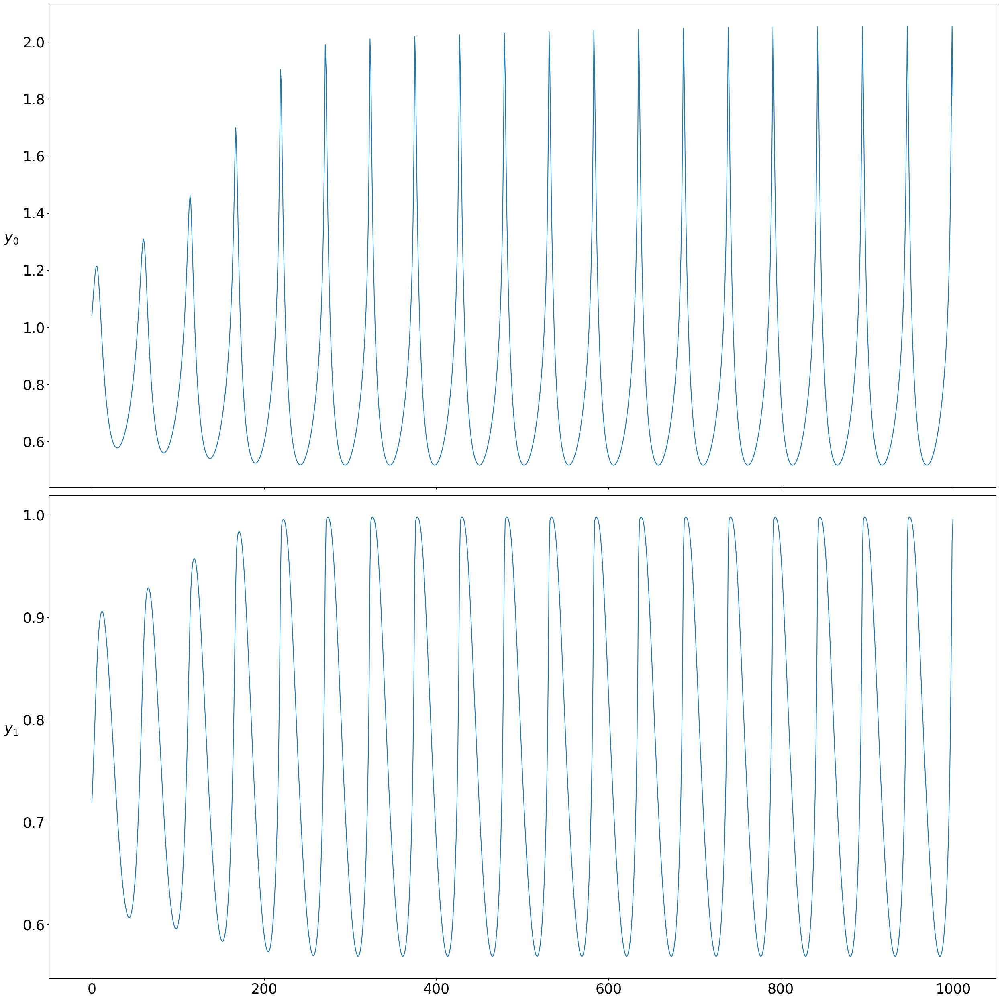

Brusselator1D


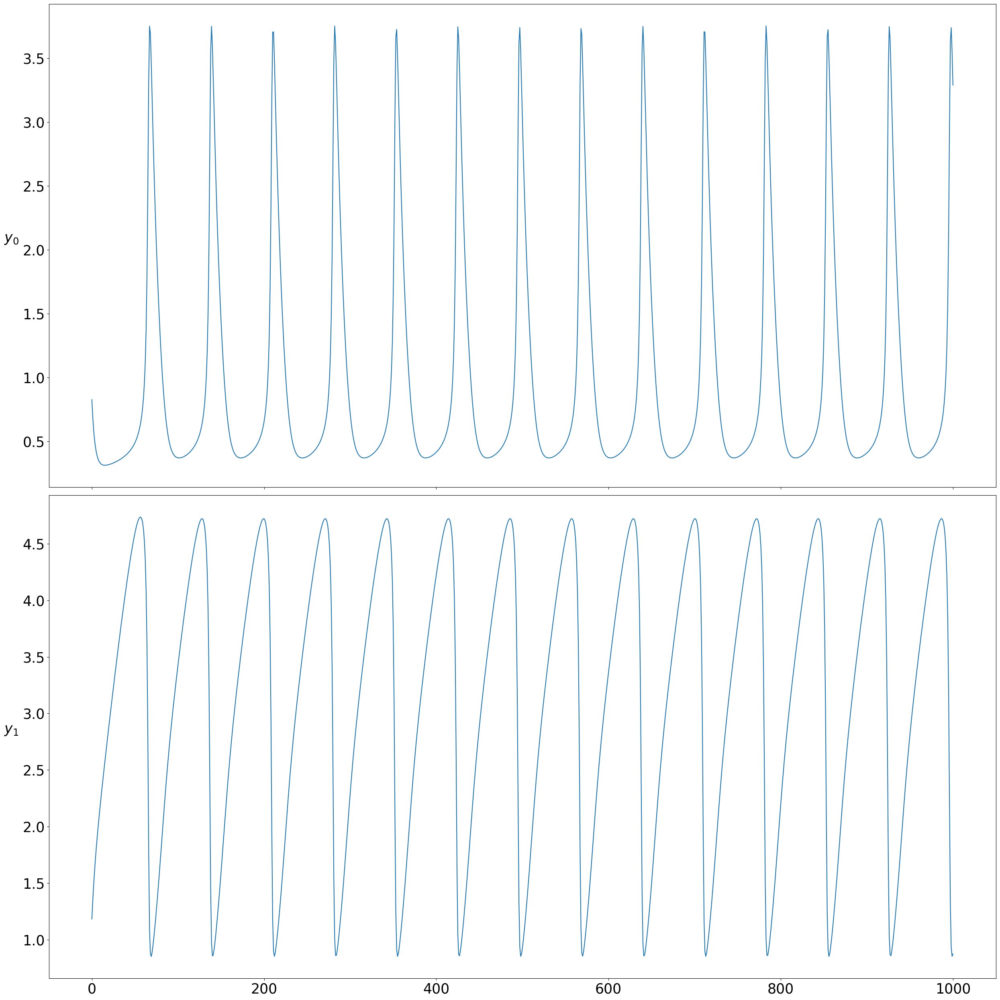

ChuaCircuit


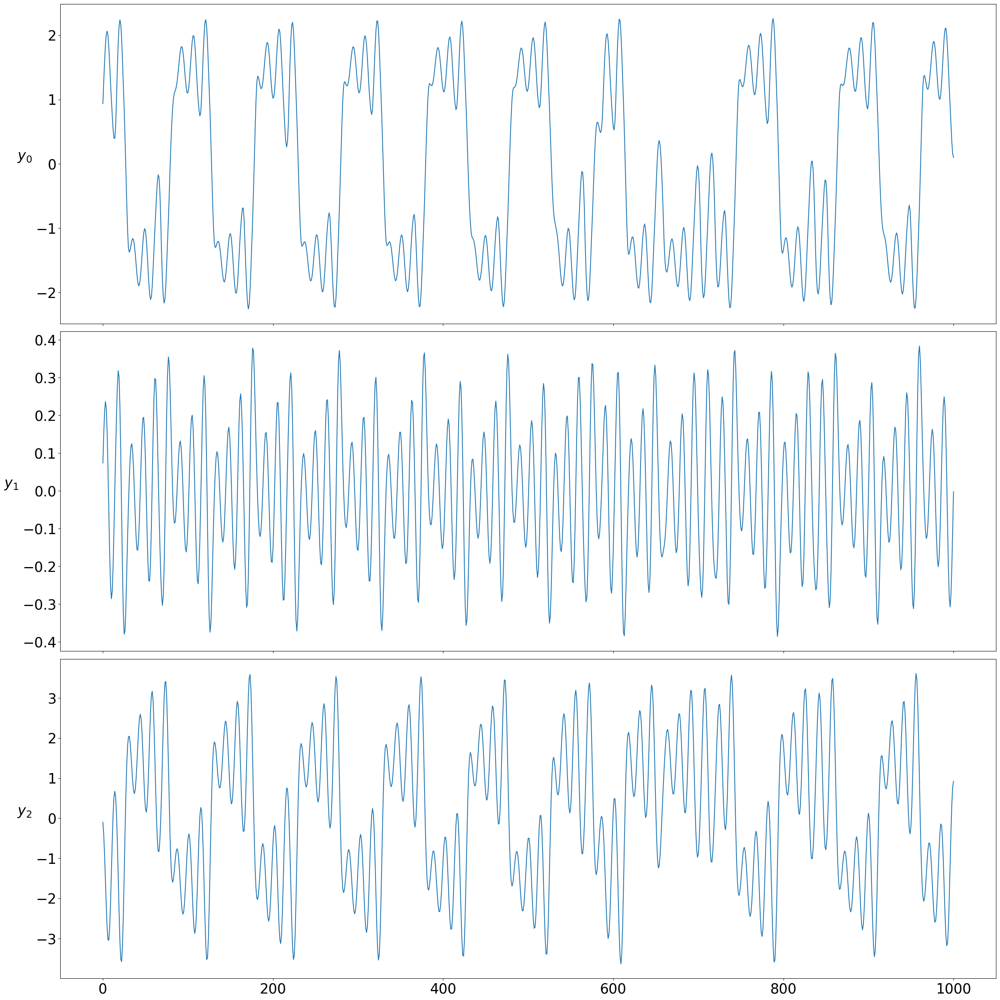

DoublePendulum


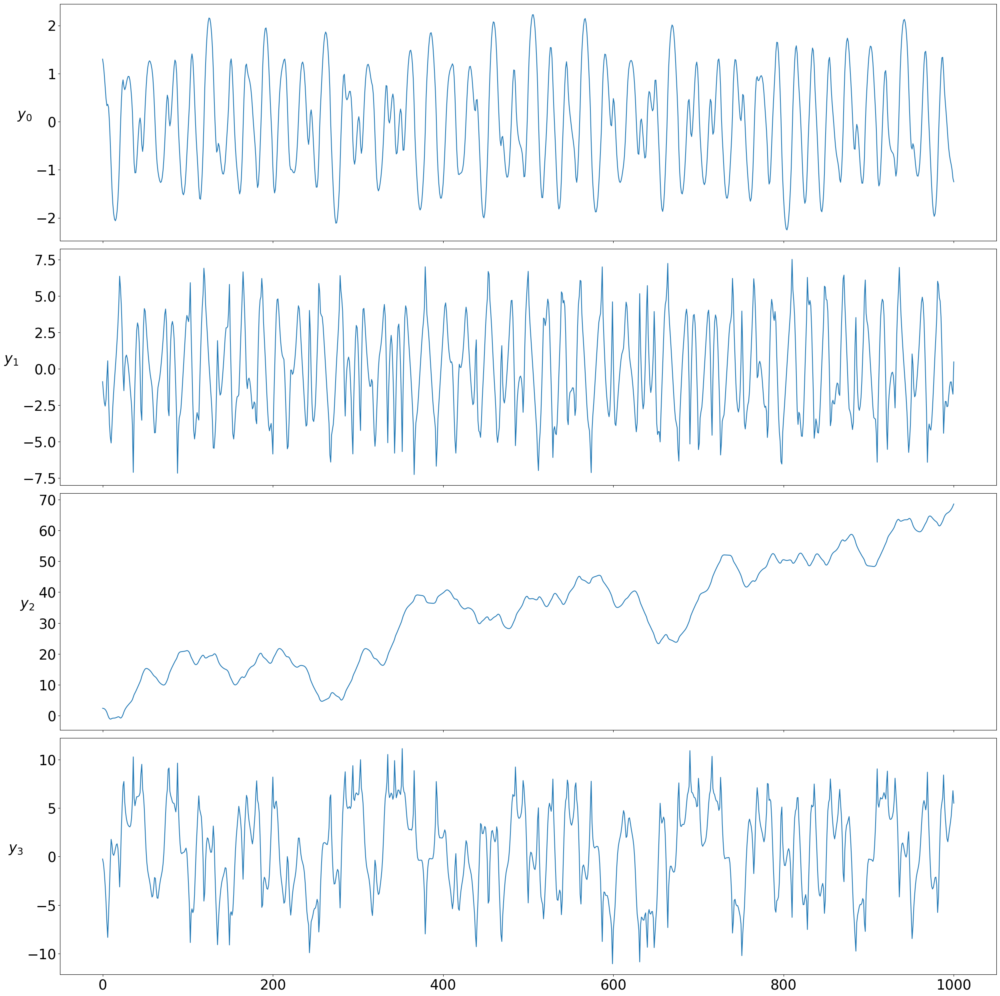

Duffing


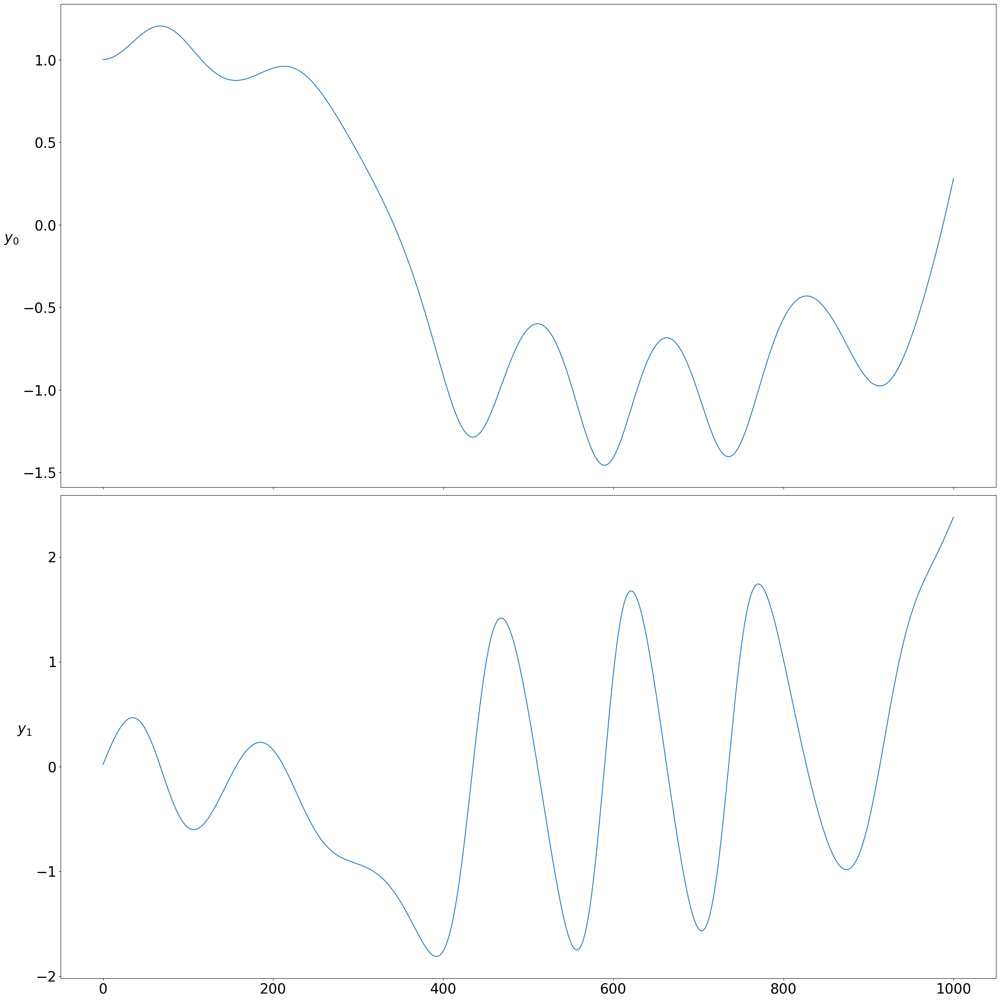

LorenzSystem


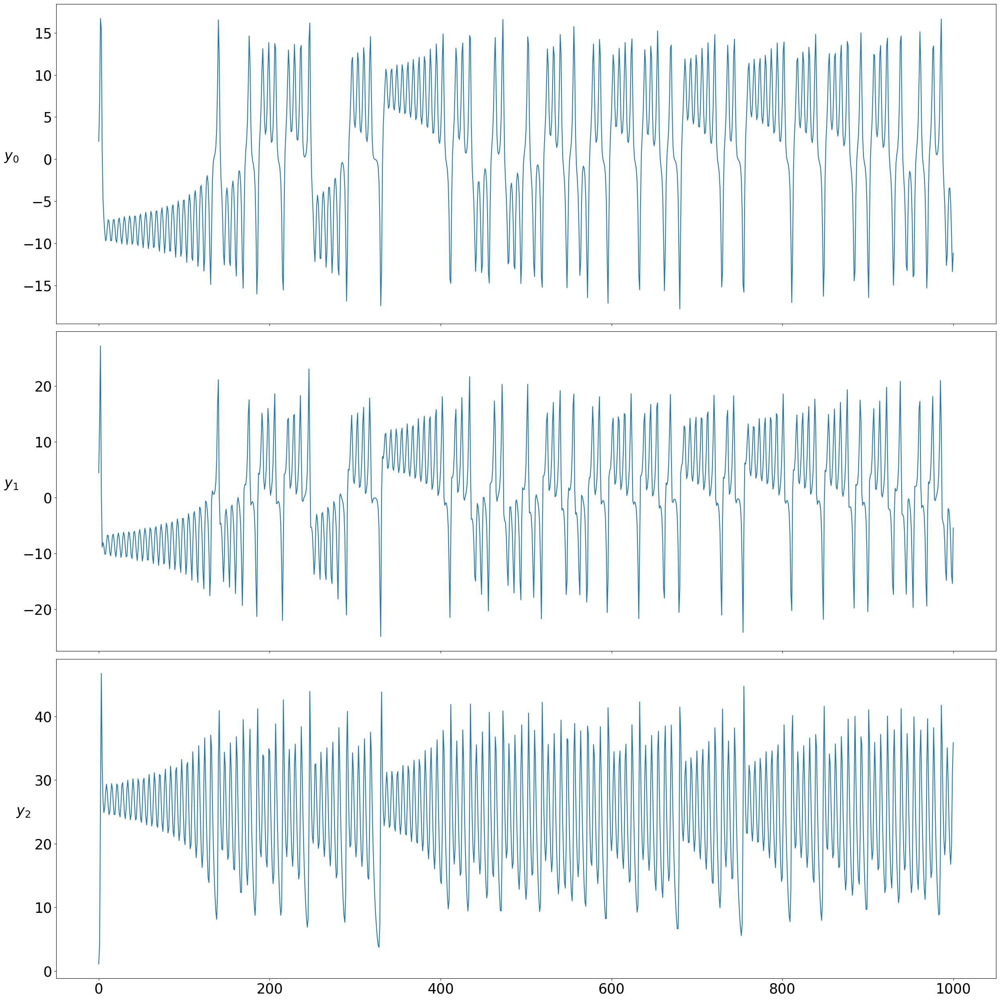

LotkaVolterra


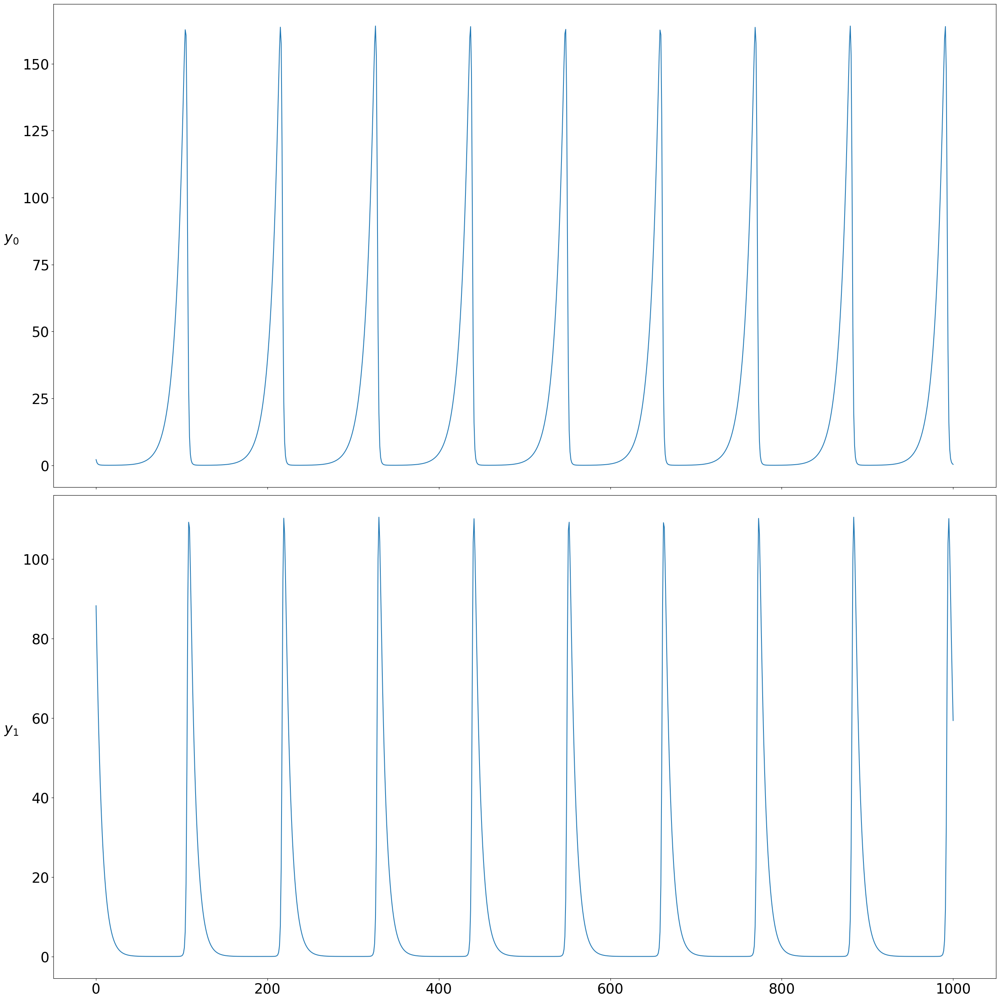

Pendulum


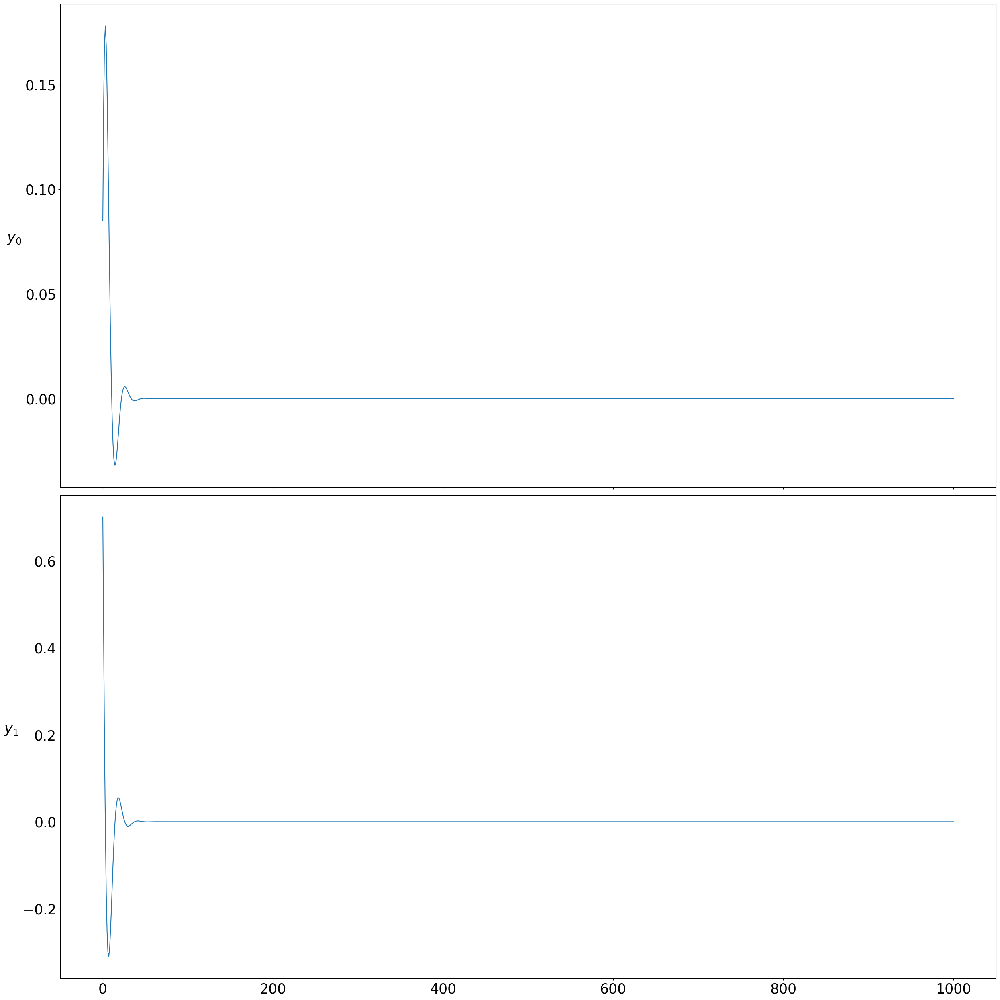

RosslerAttractor


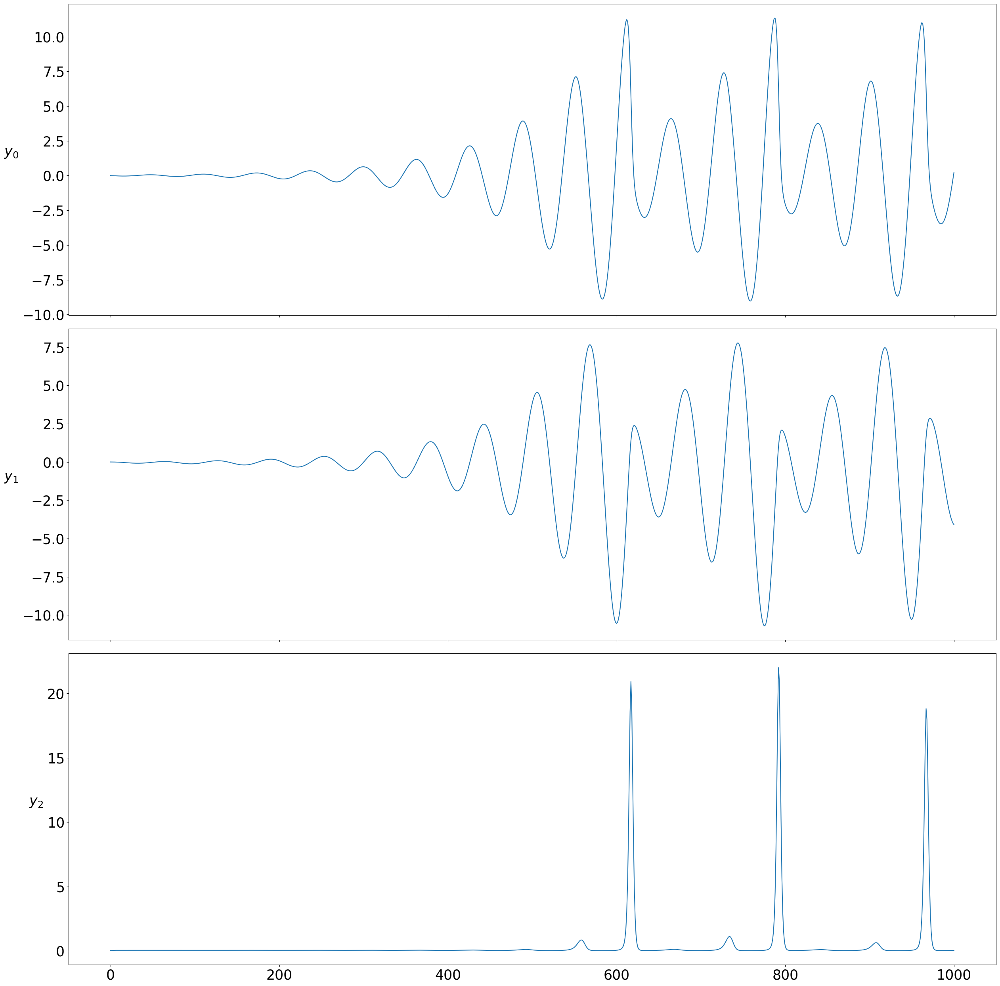

ThomasAttractor


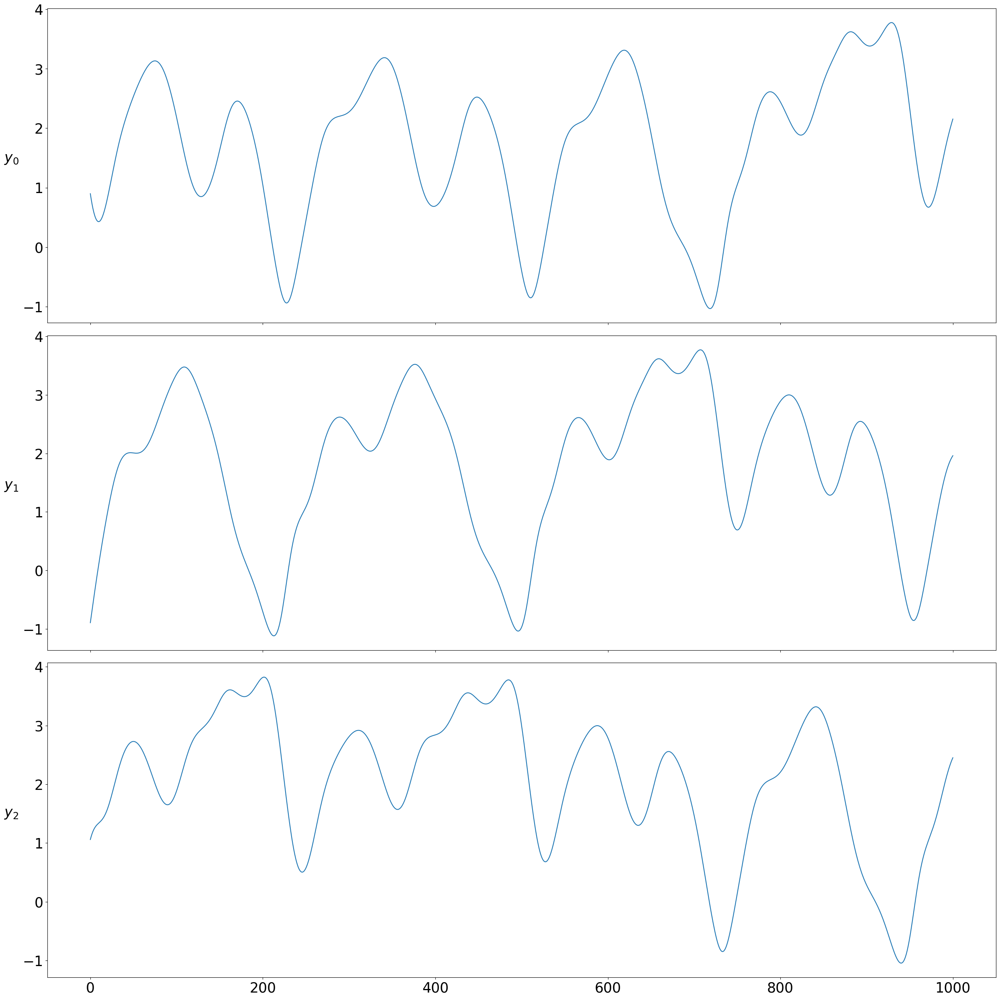

UniversalOscillator


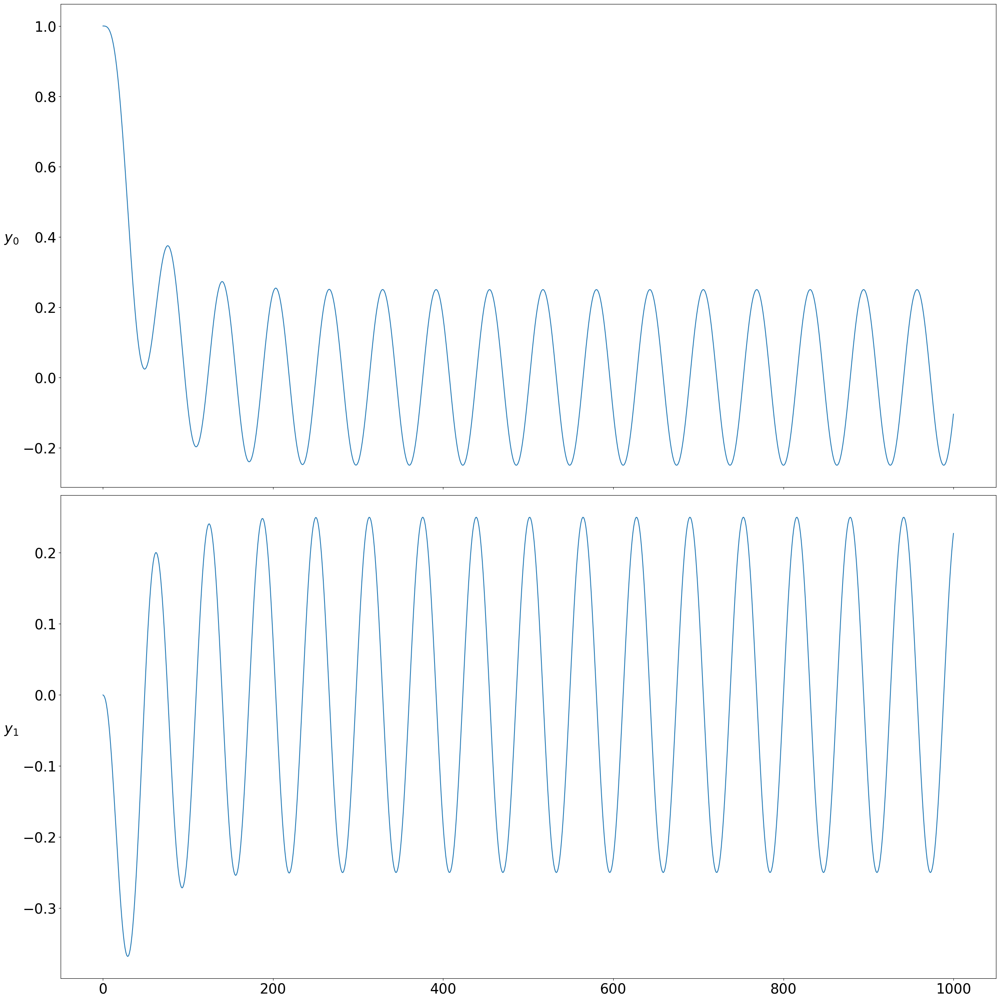

VanDerPol


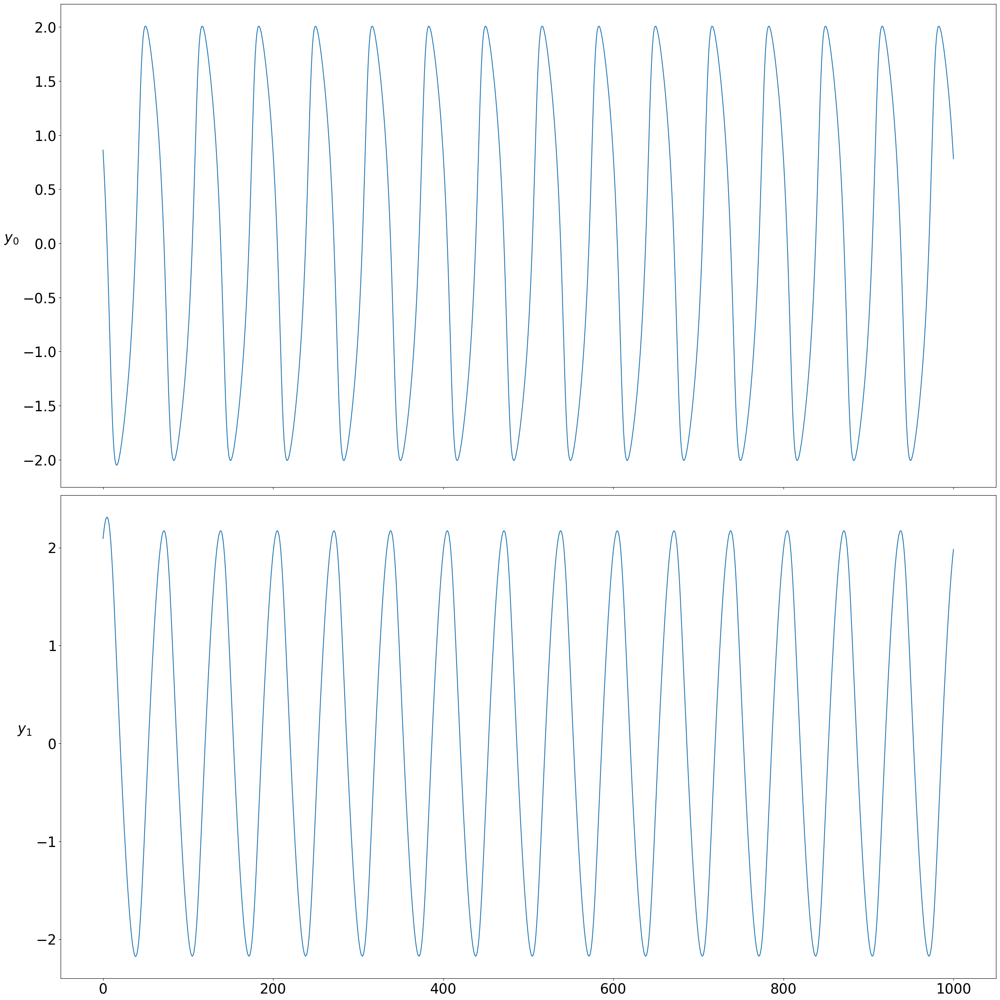

Actuator


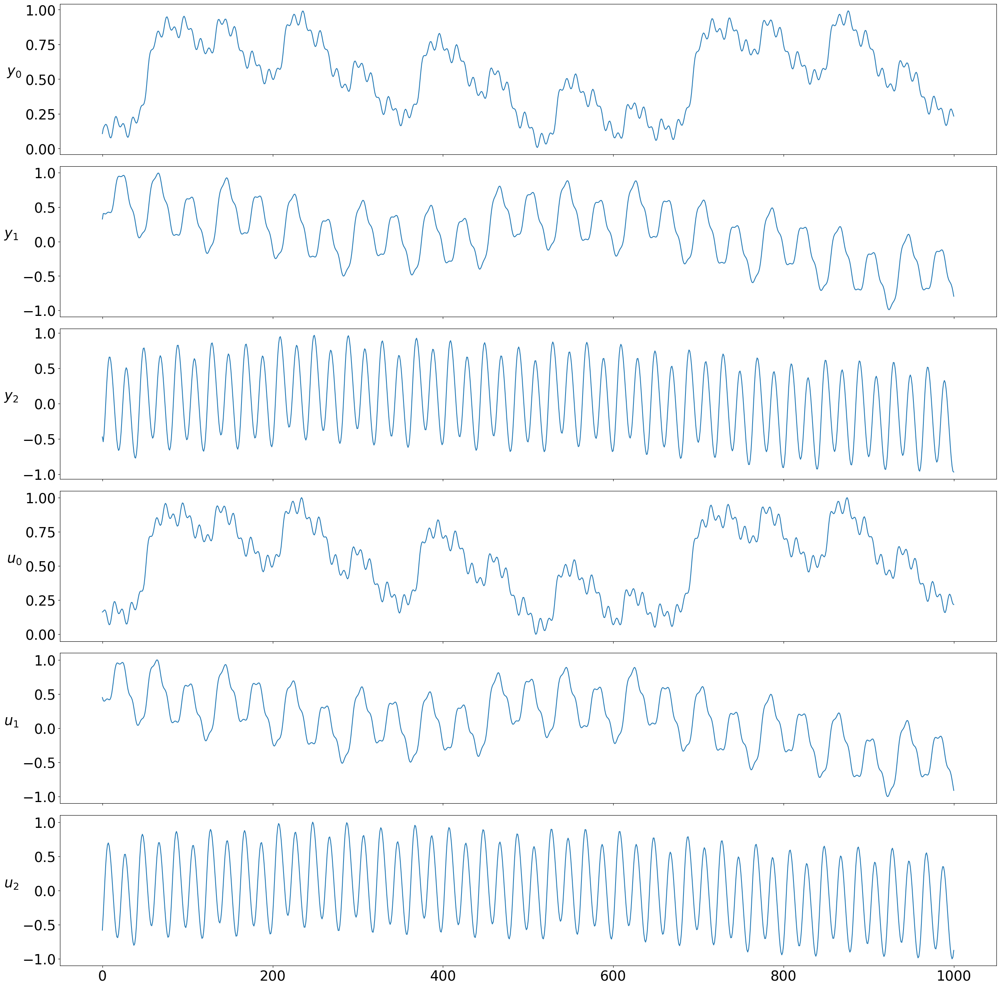

CSTR


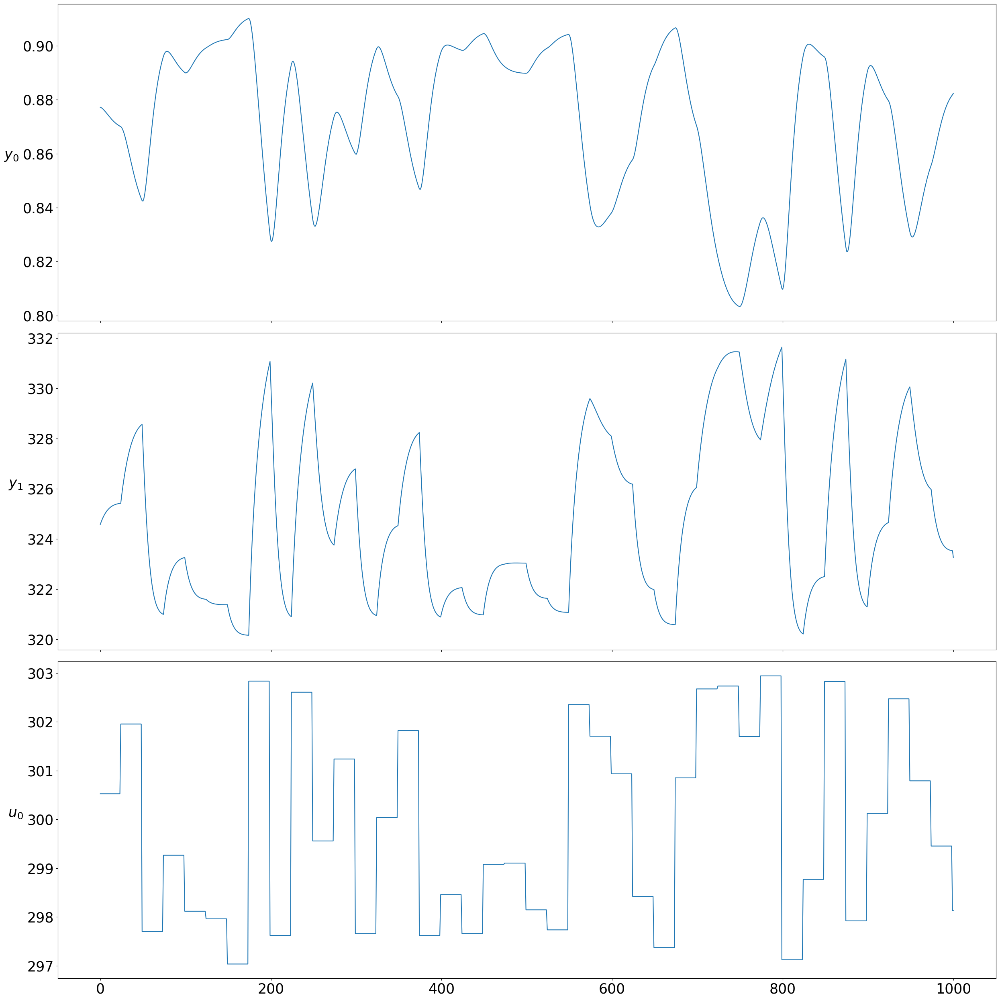

DuffingControl


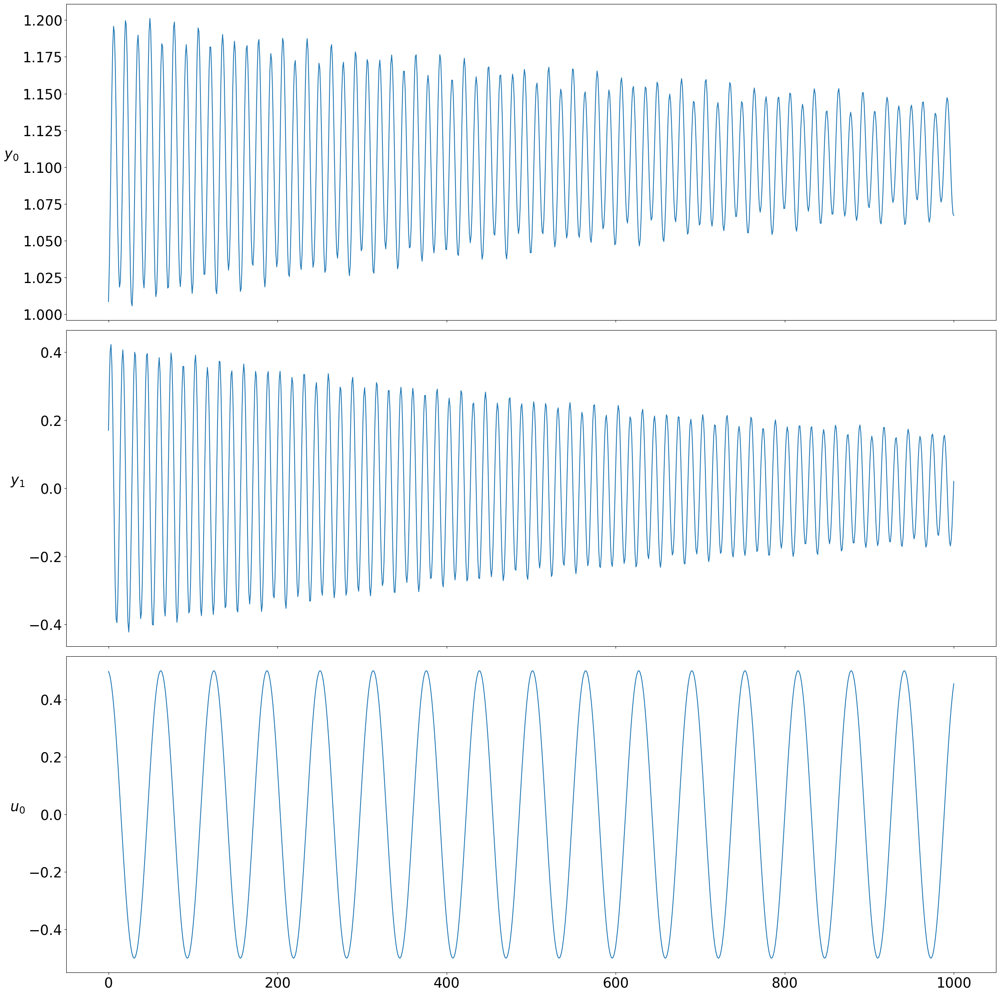

HindmarshRose


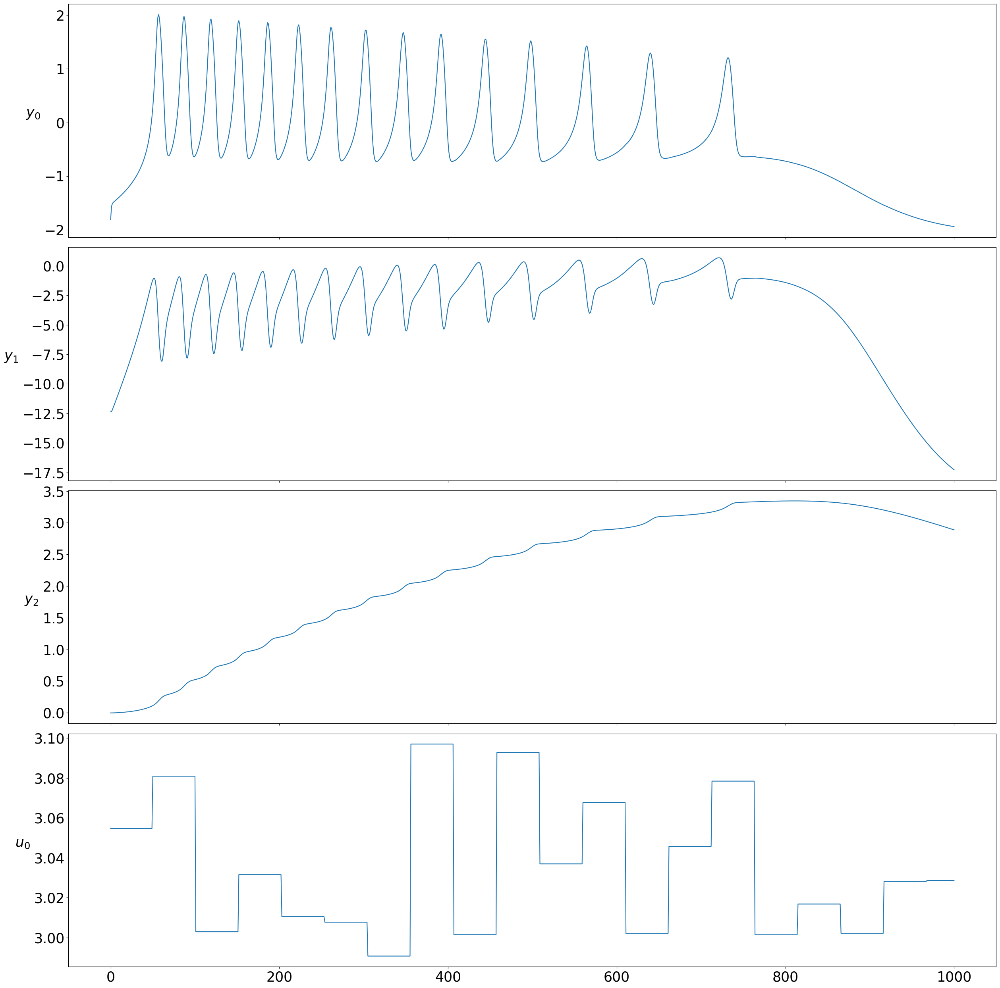

InvPendulum


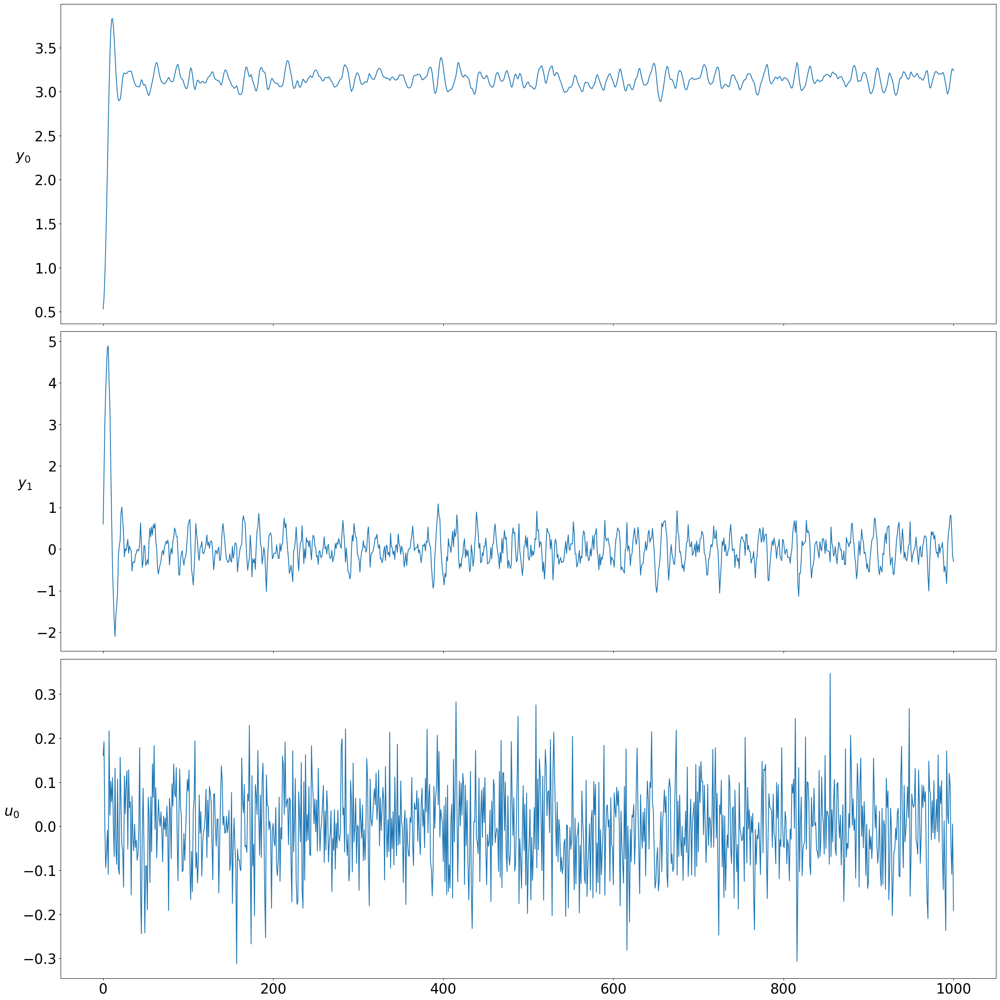

IverSimple


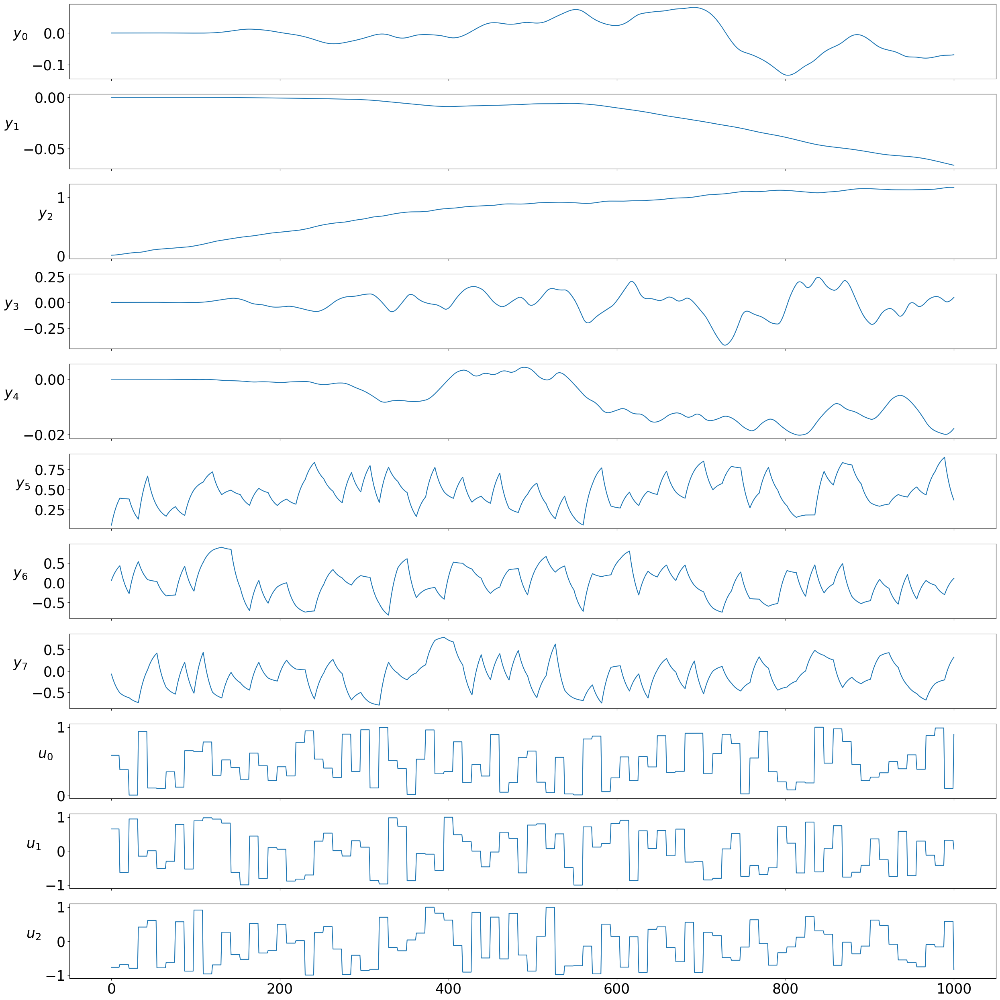

LorenzControl


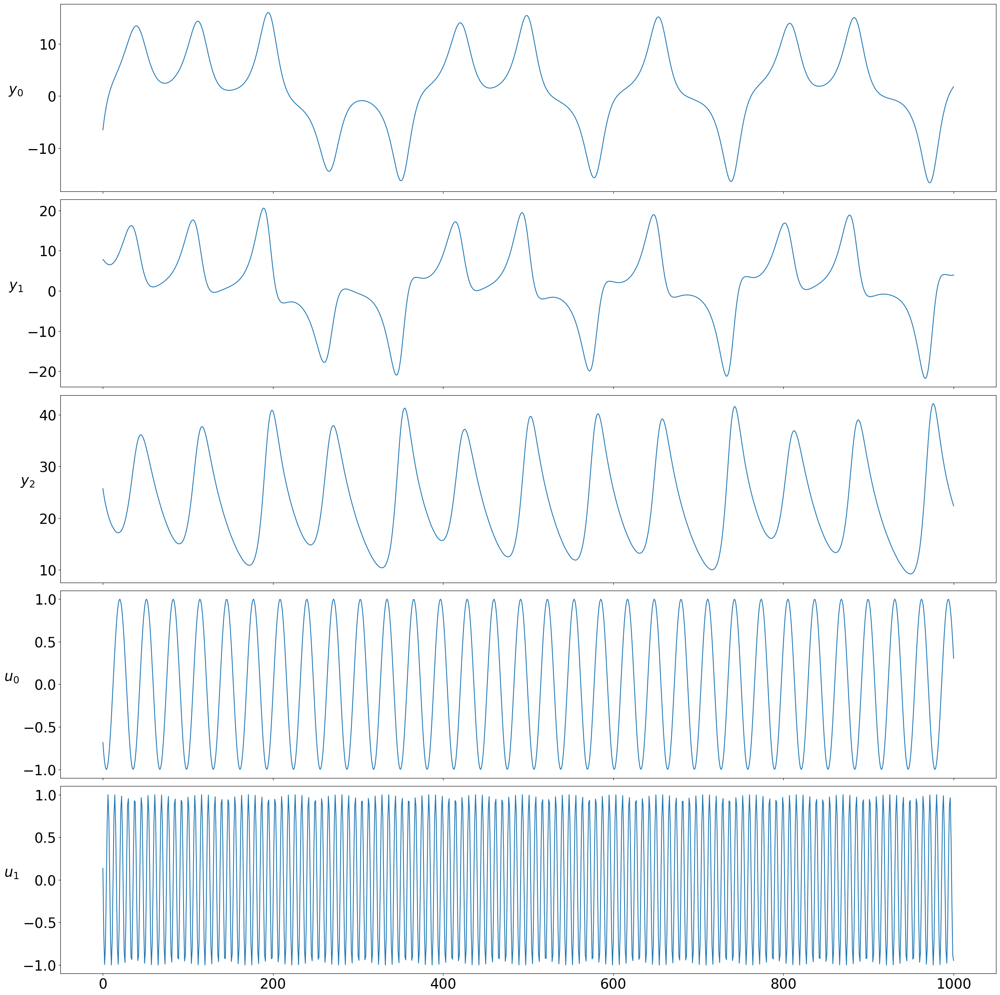

SEIR_population


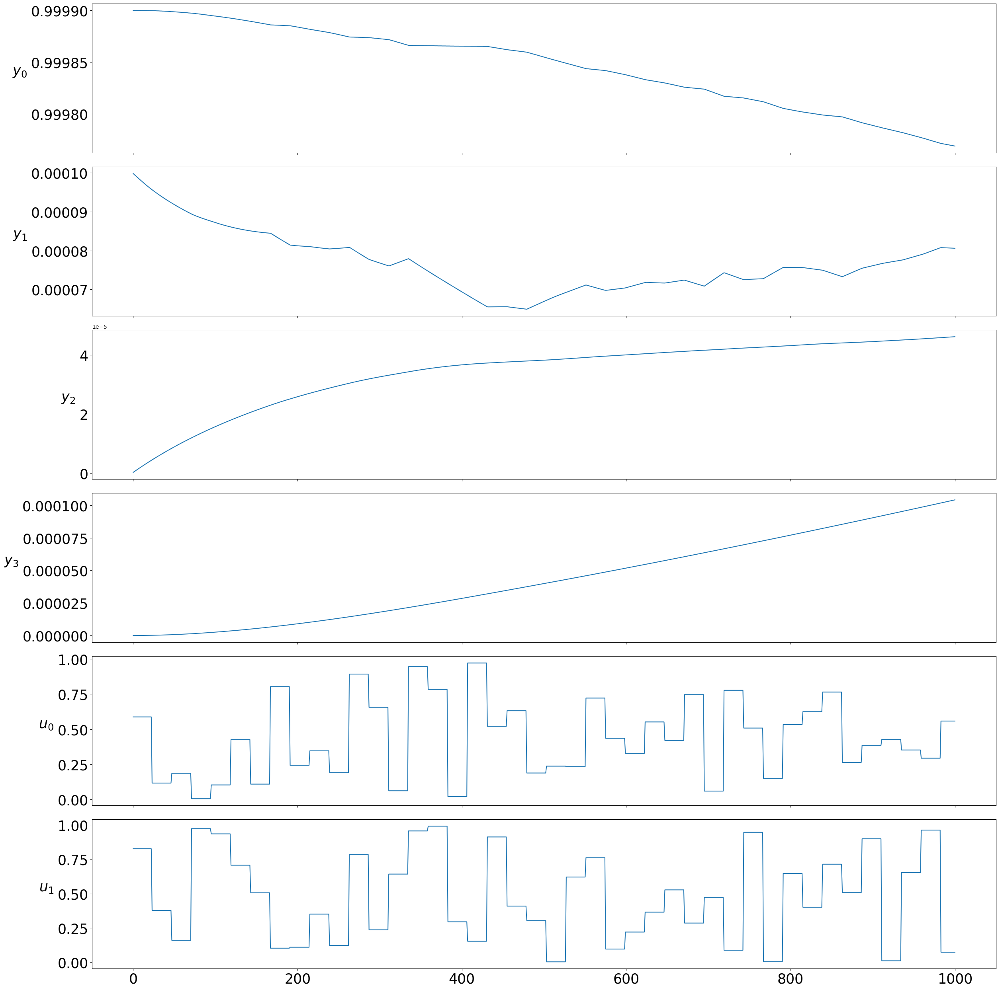

SwingEquation


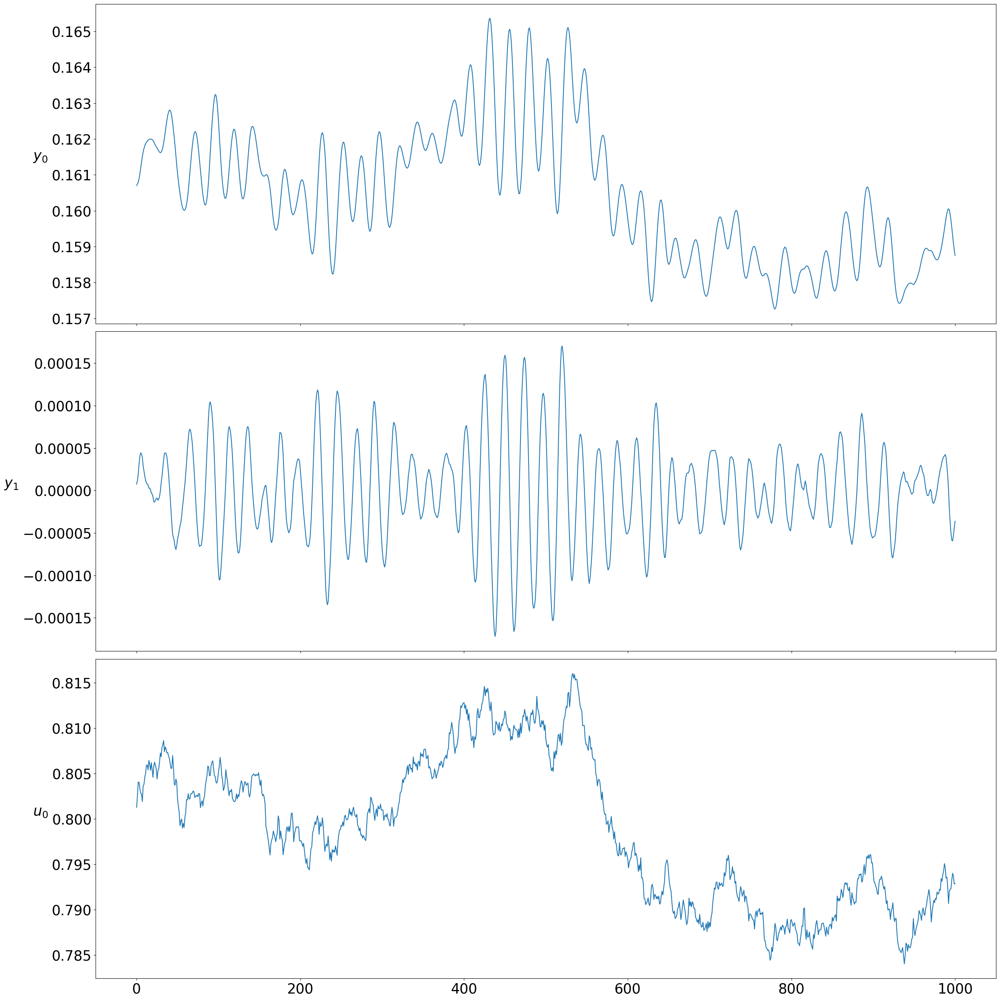

Tank


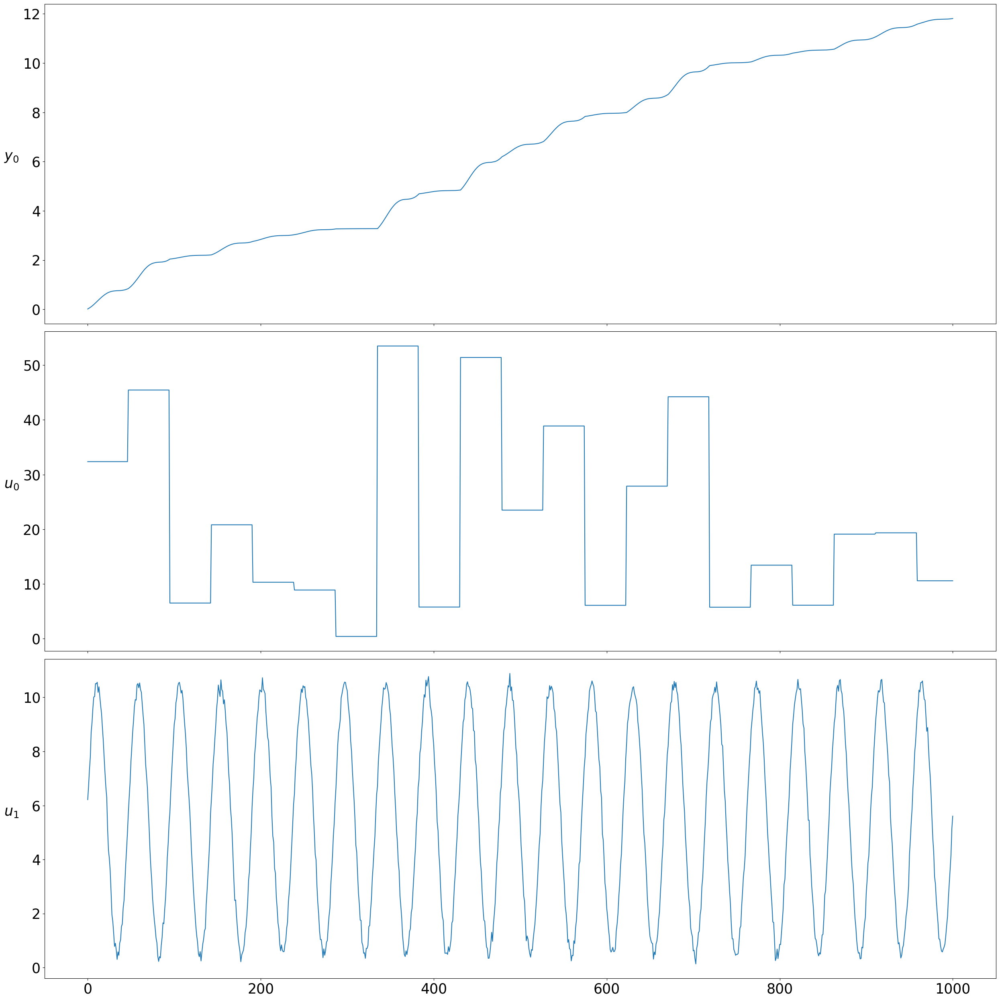

ThomasAttractorControl


C:\Users\drgo694\OneDrive - PNNL\Documents\Codes_dev\neuromancer\neuromancer\src\neuromancer\psl\base.py:278: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  plt.tight_layout()


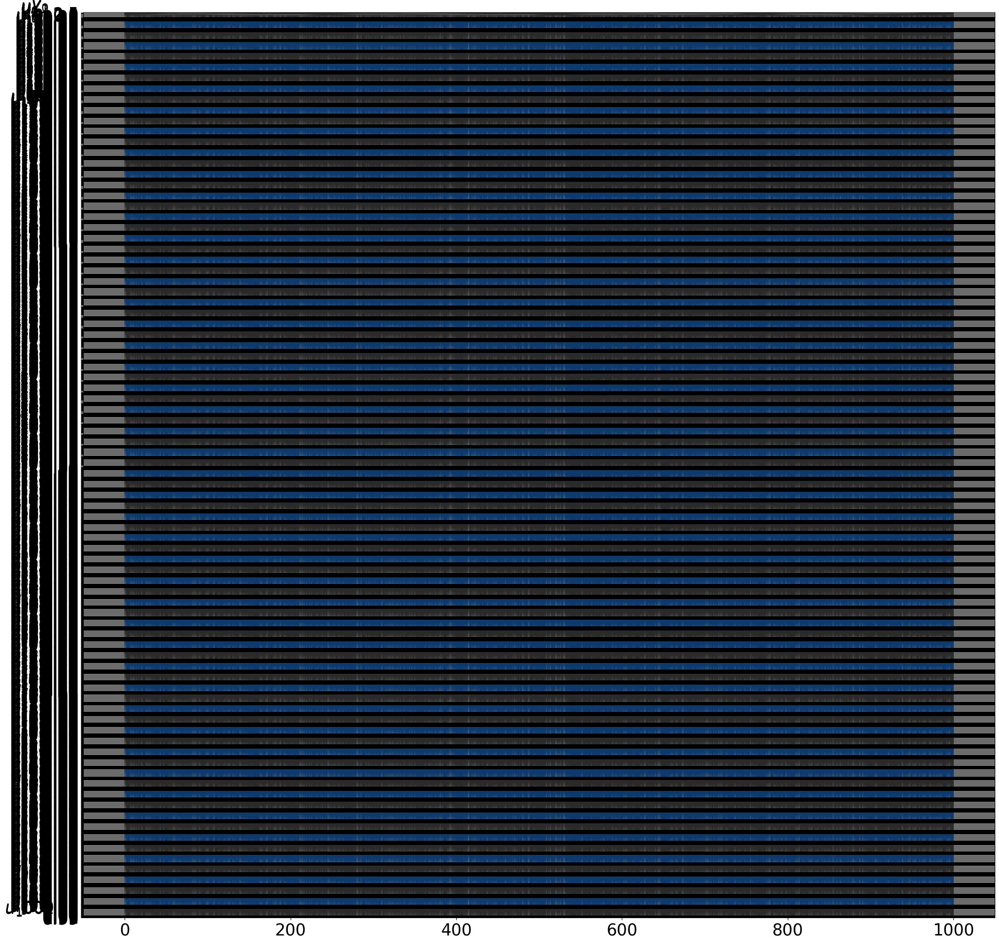

TwoTank


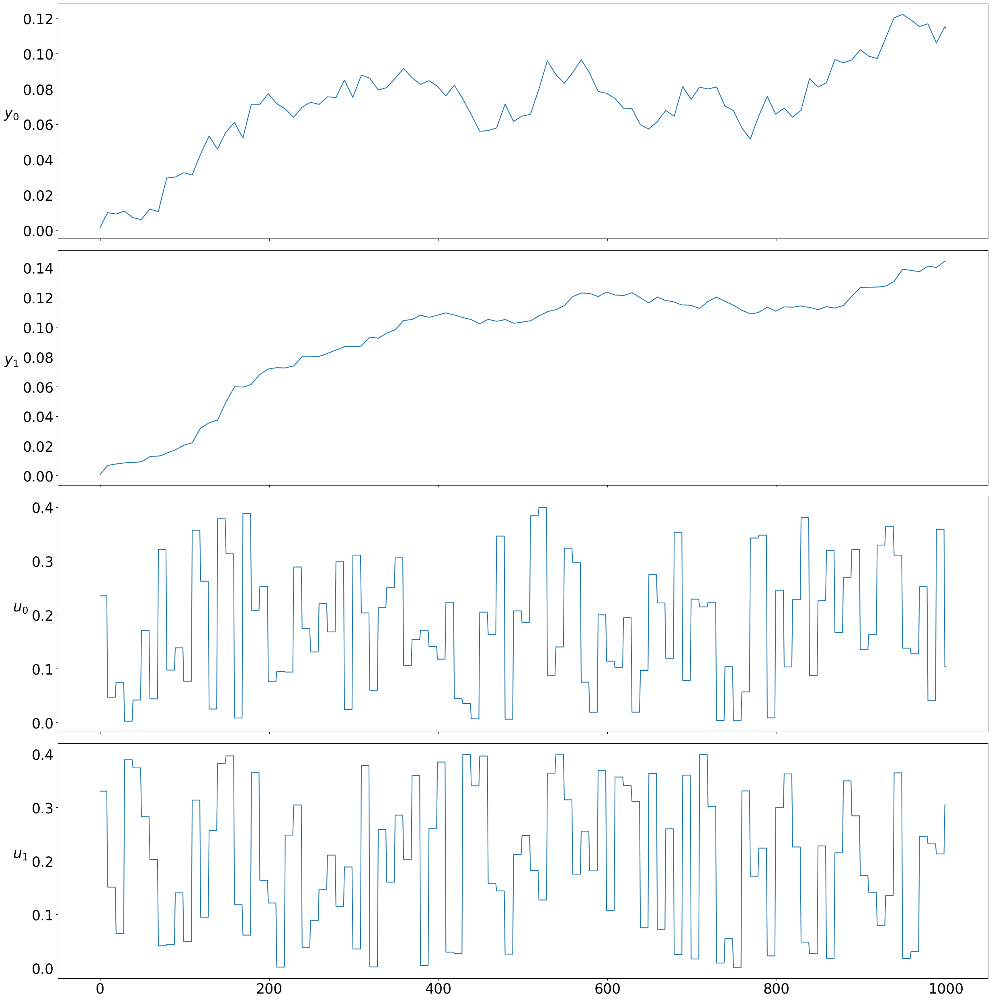

VanDerPolControl


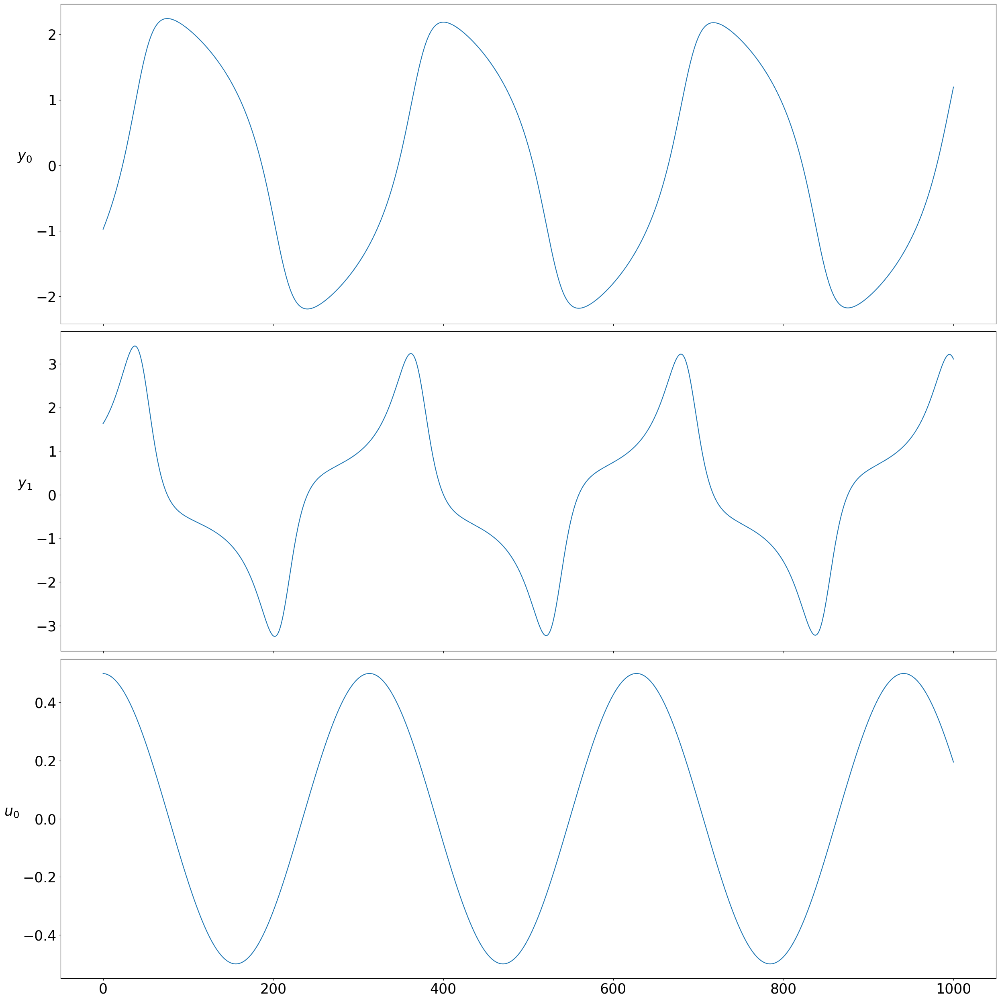

SimpleSingleZone


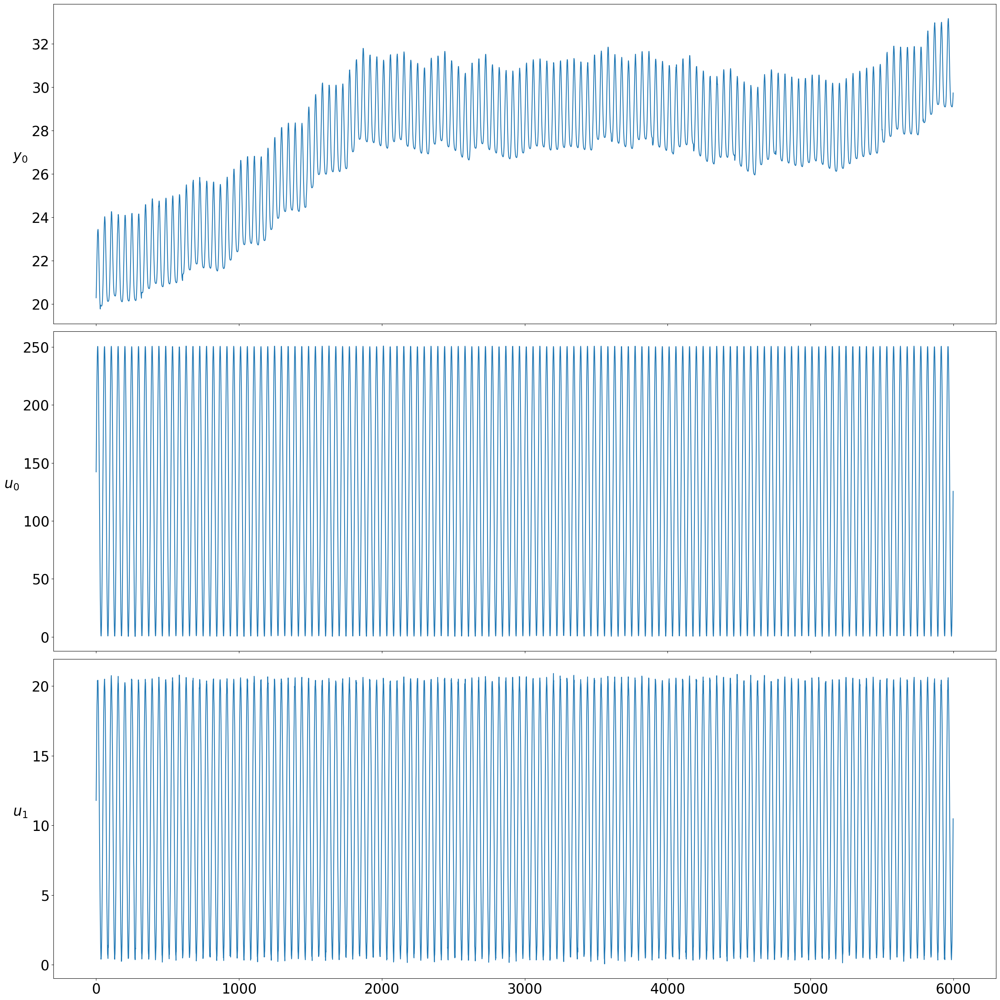

Reno_full


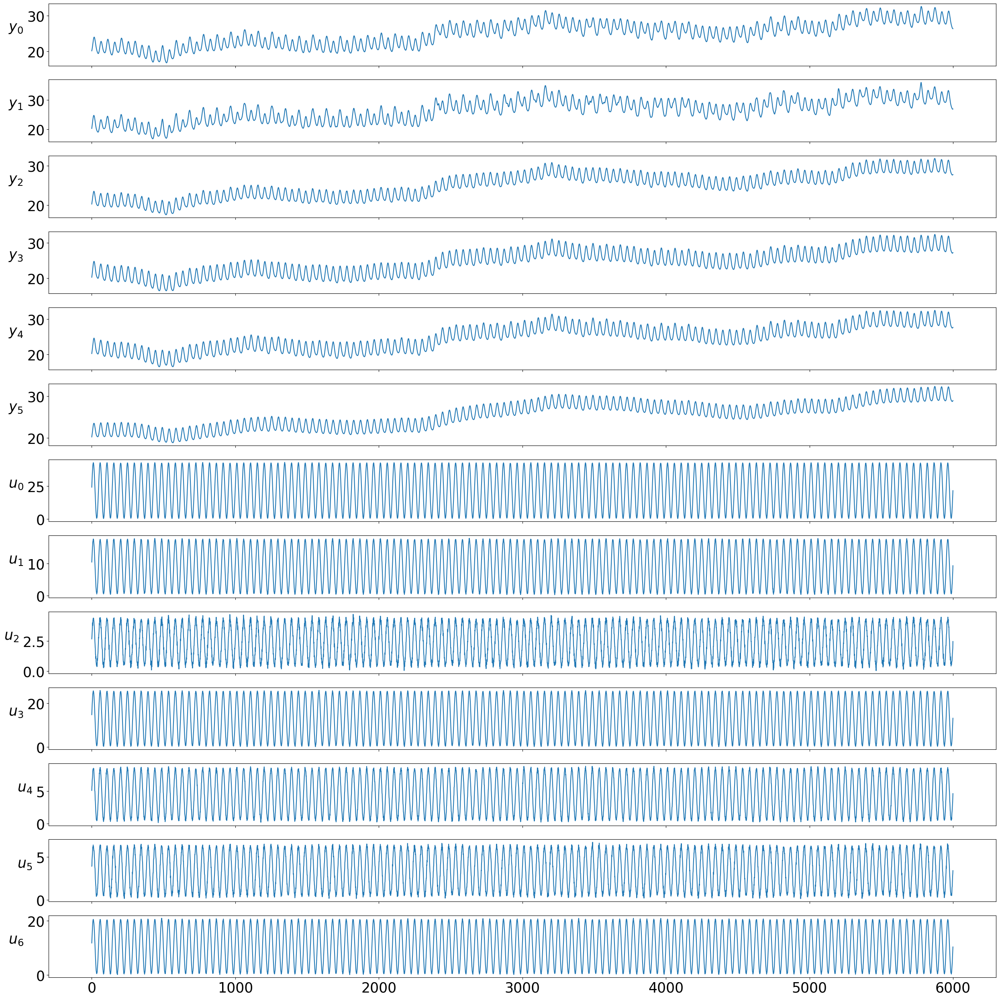

Reno_ROM40


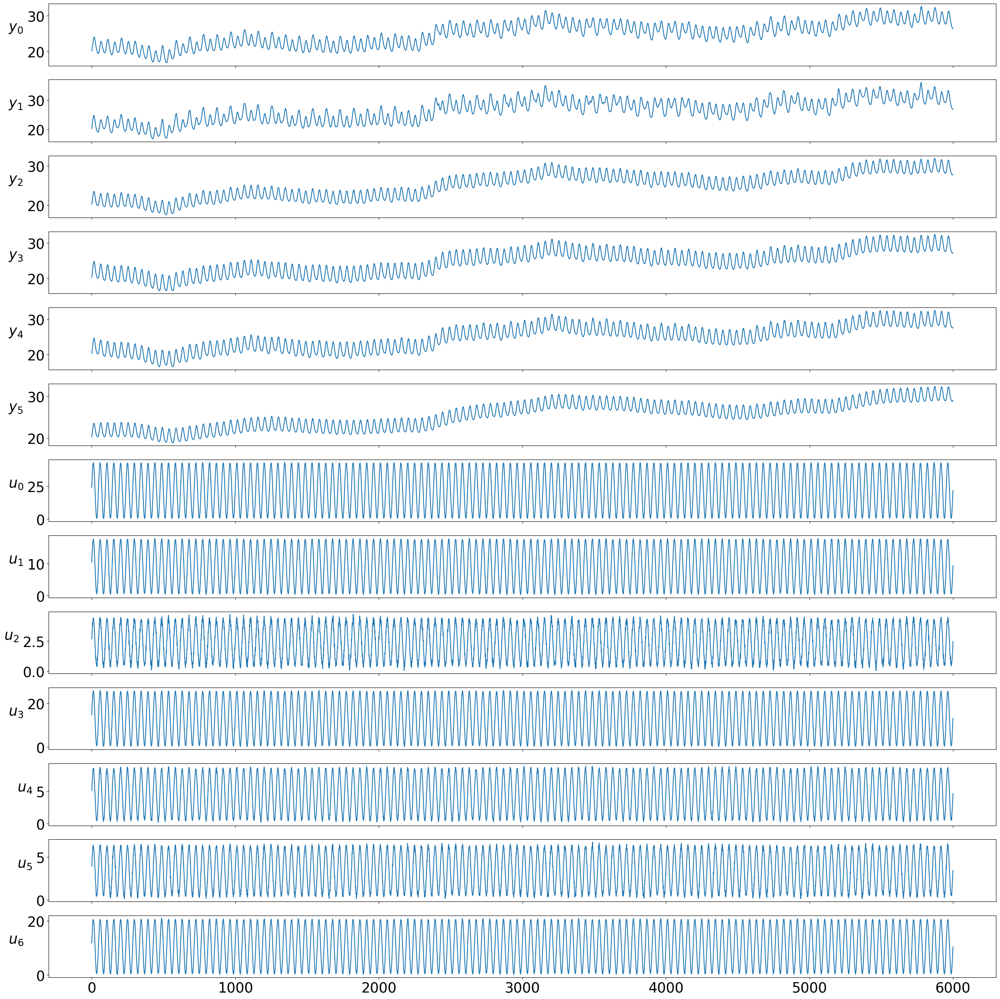

RenoLight_full


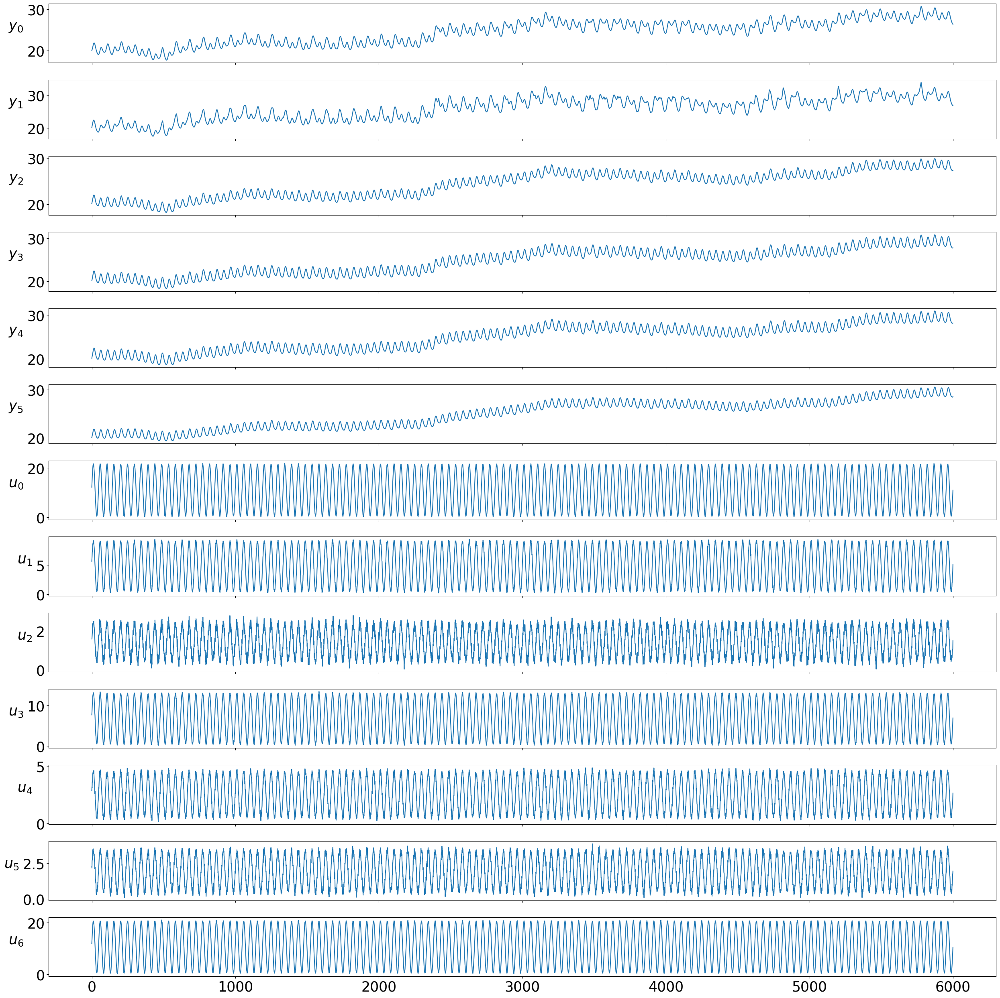

RenoLight_ROM40


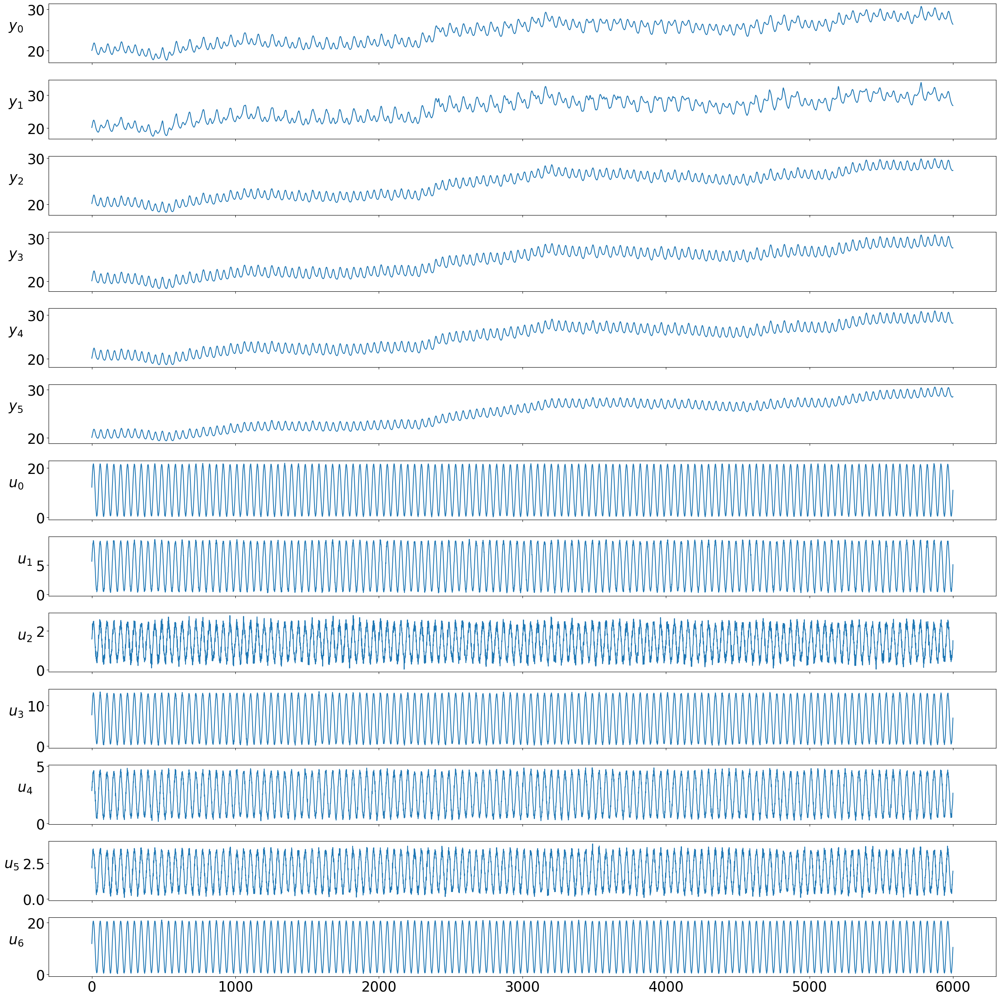

Old_full


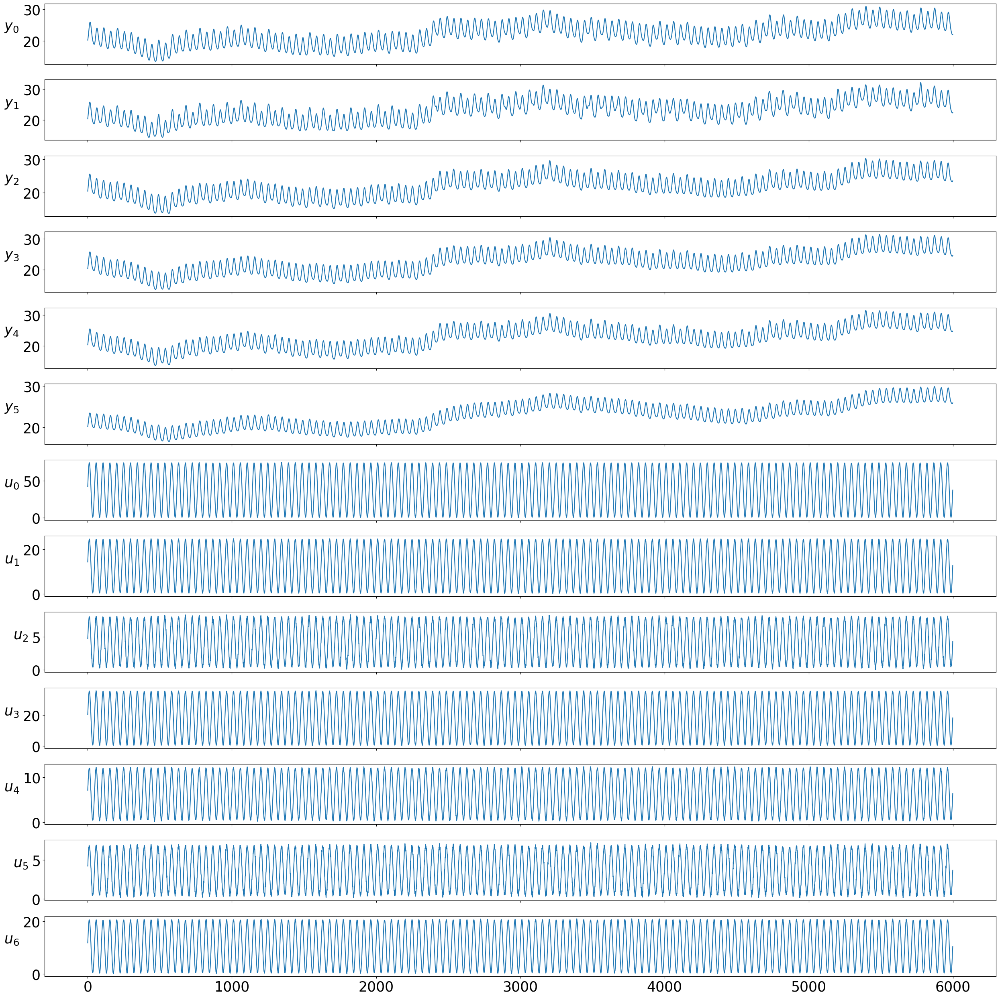

Old_ROM40


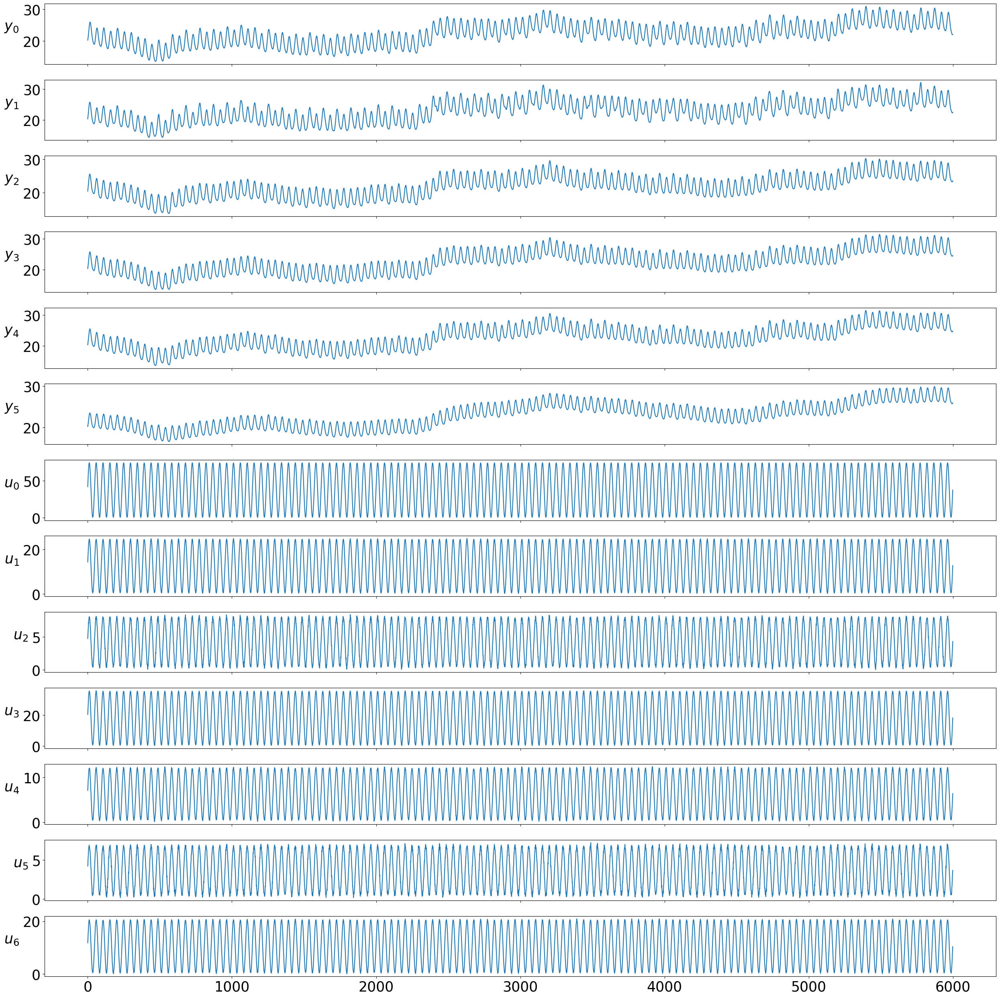

HollandschHuys_full


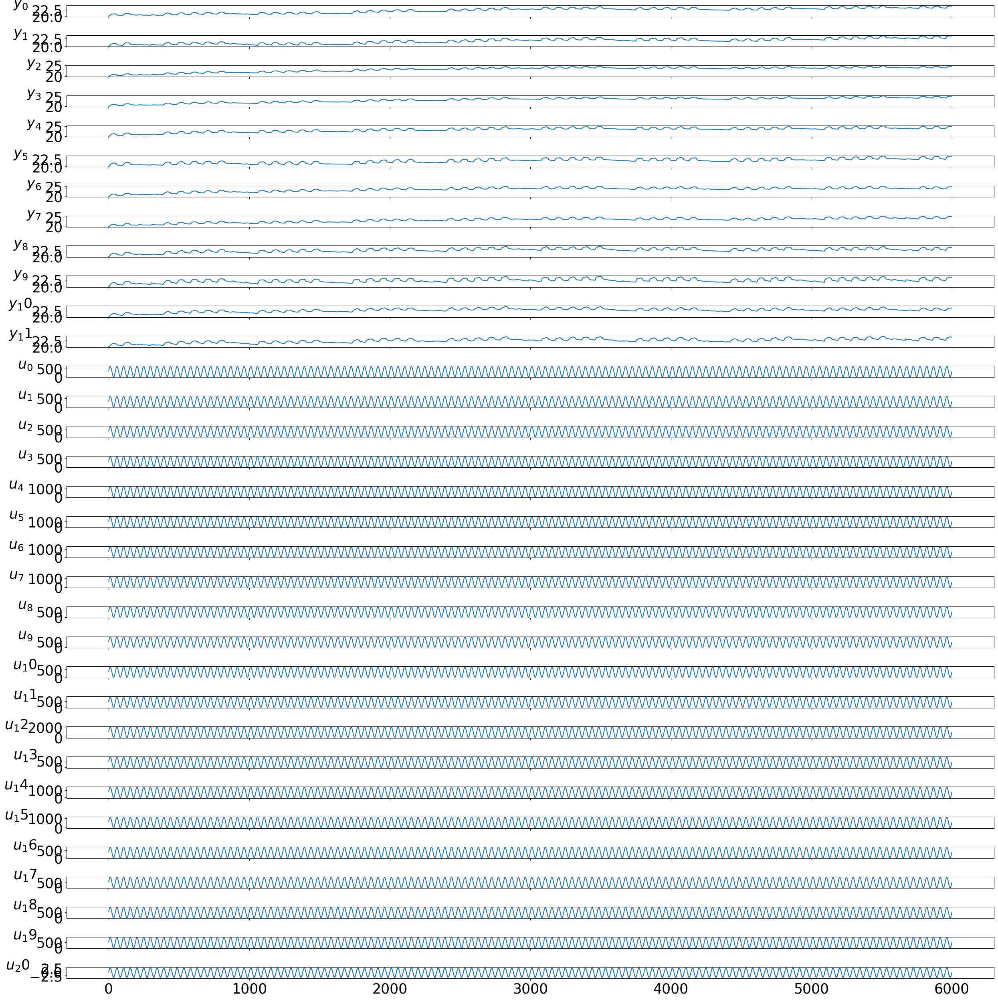

HollandschHuys_ROM100


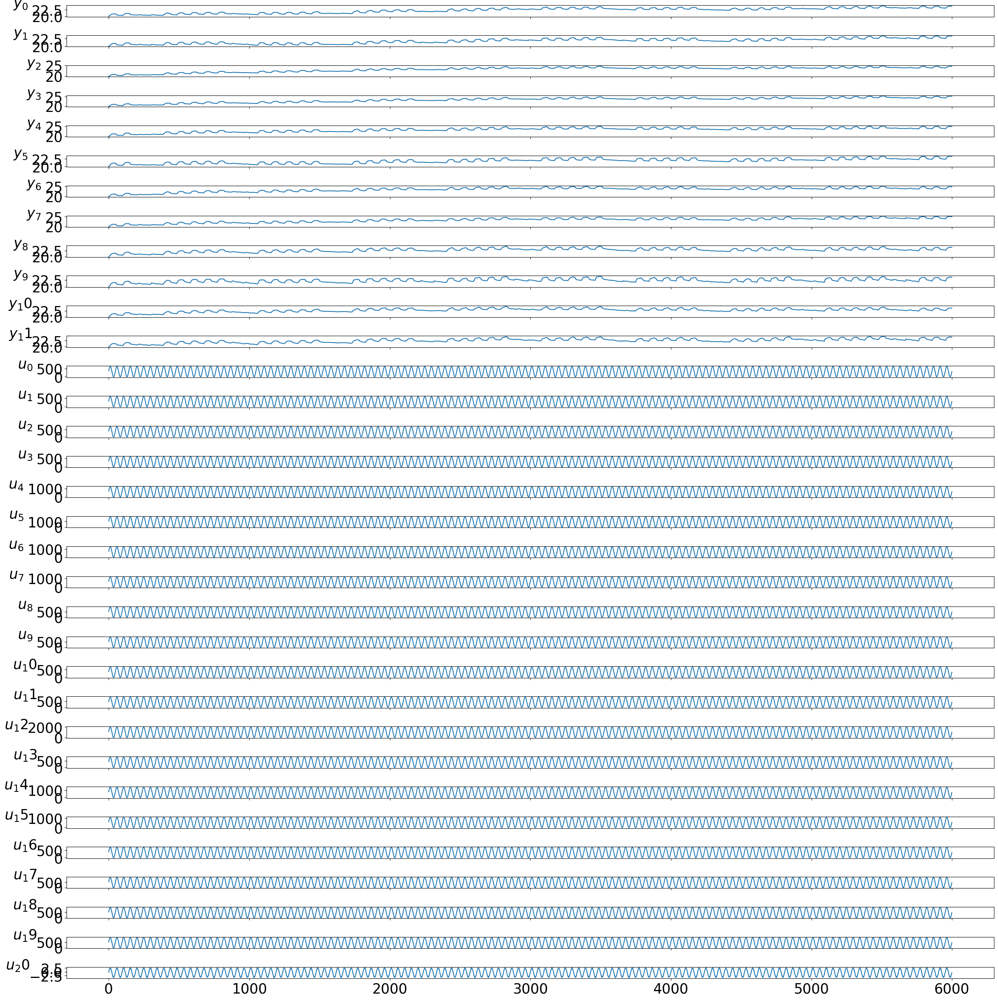

LinearSimpleSingleZone


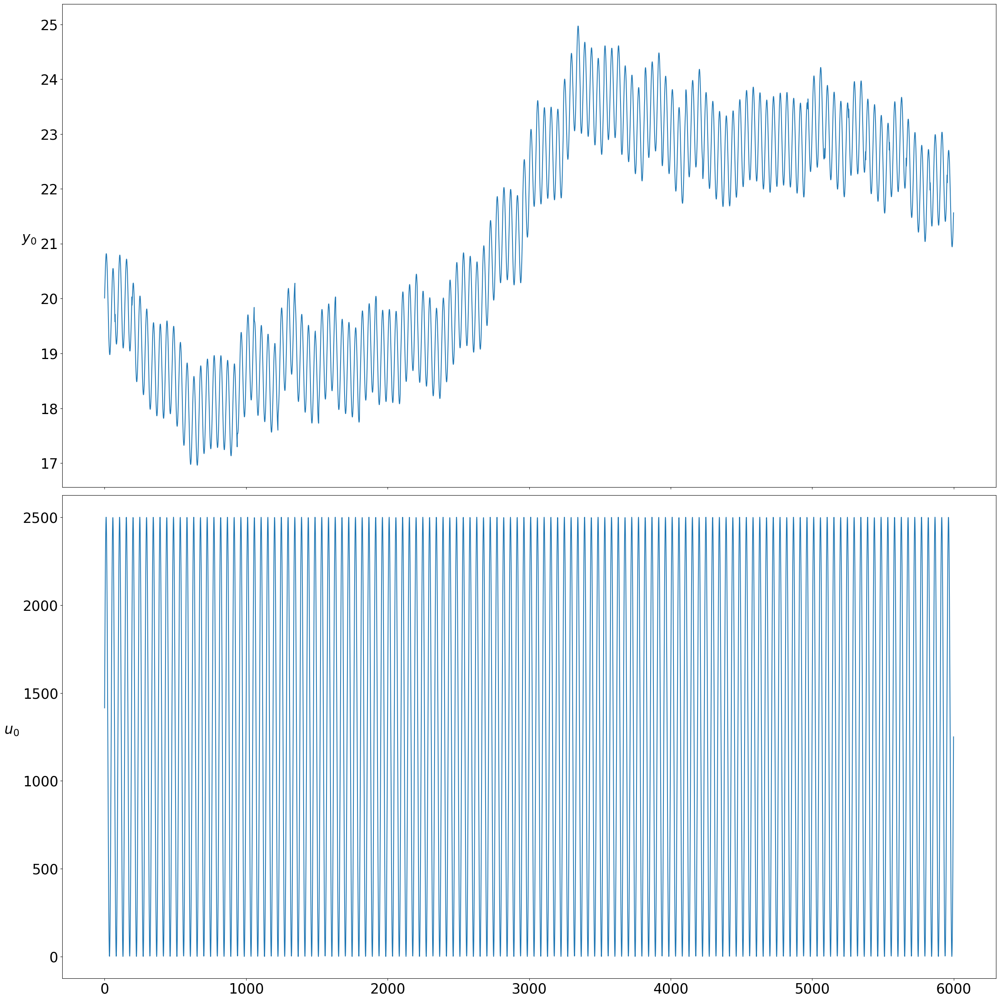

LinearReno_full


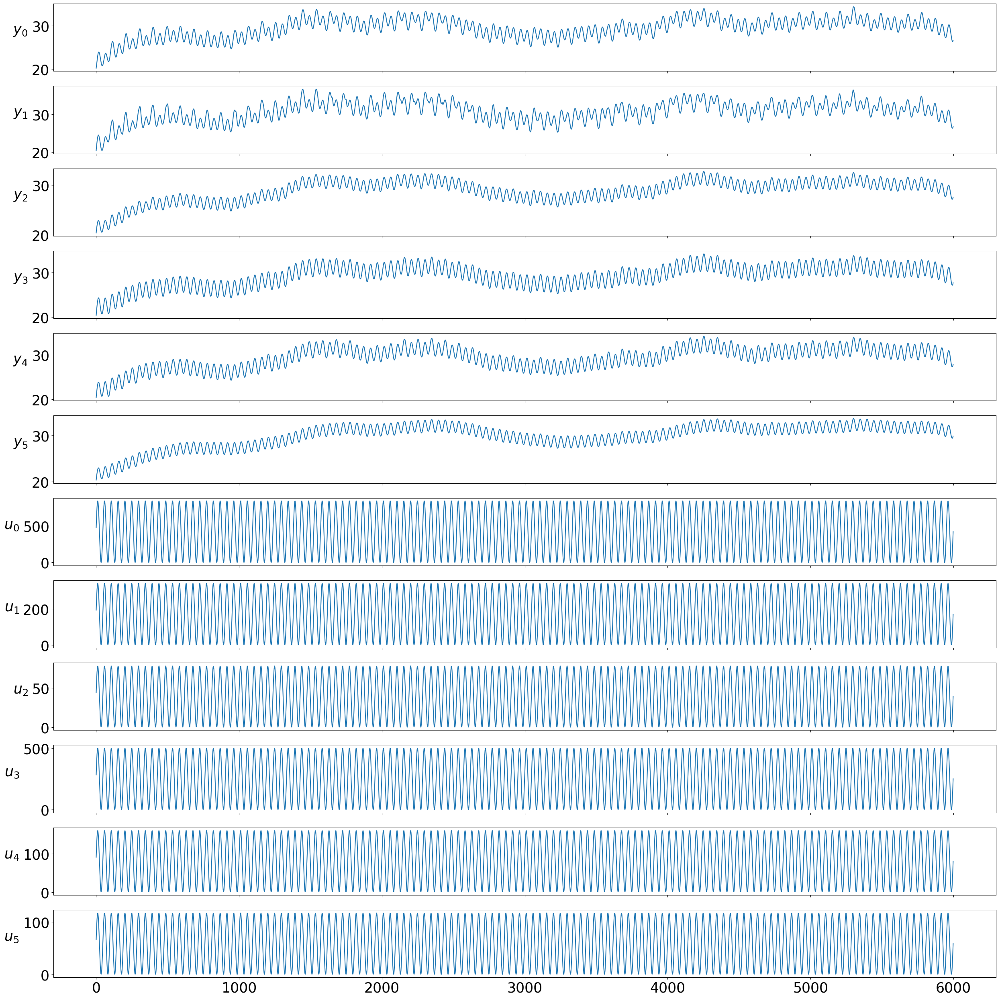

LinearReno_ROM40


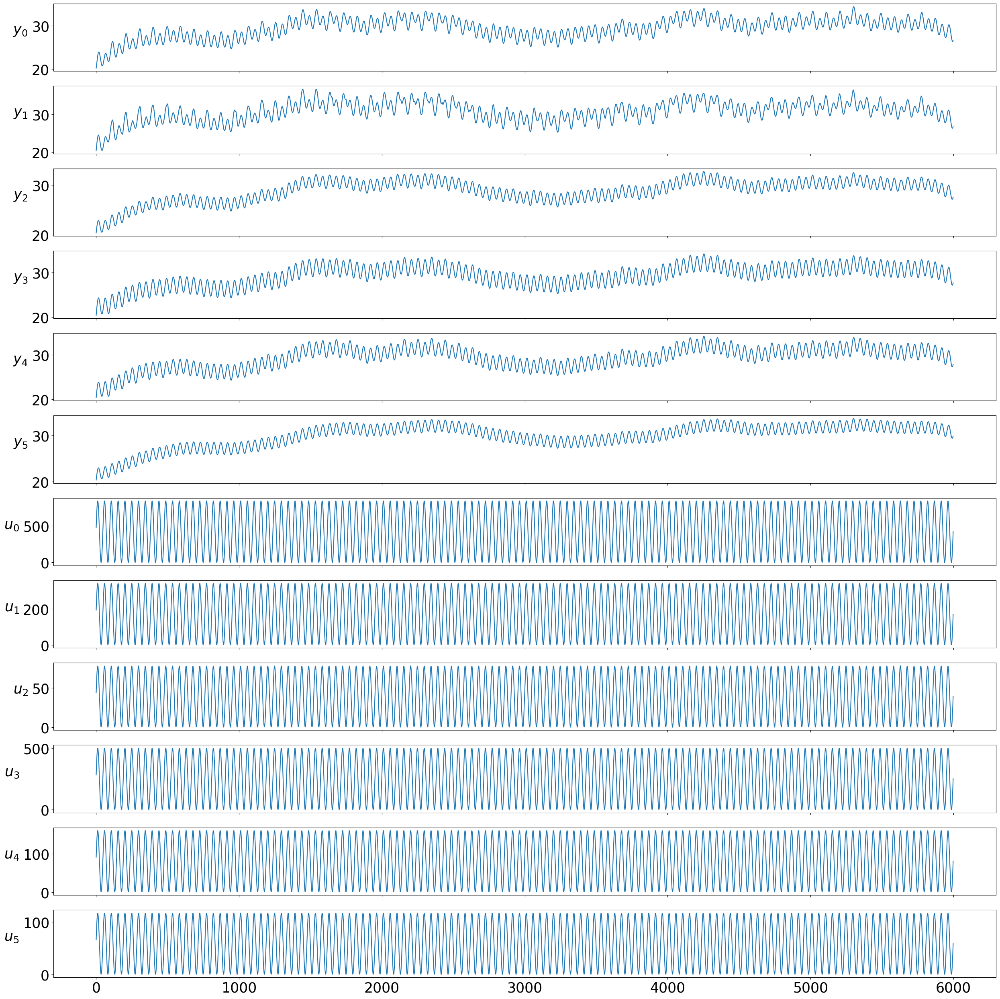

LinearRenoLight_full


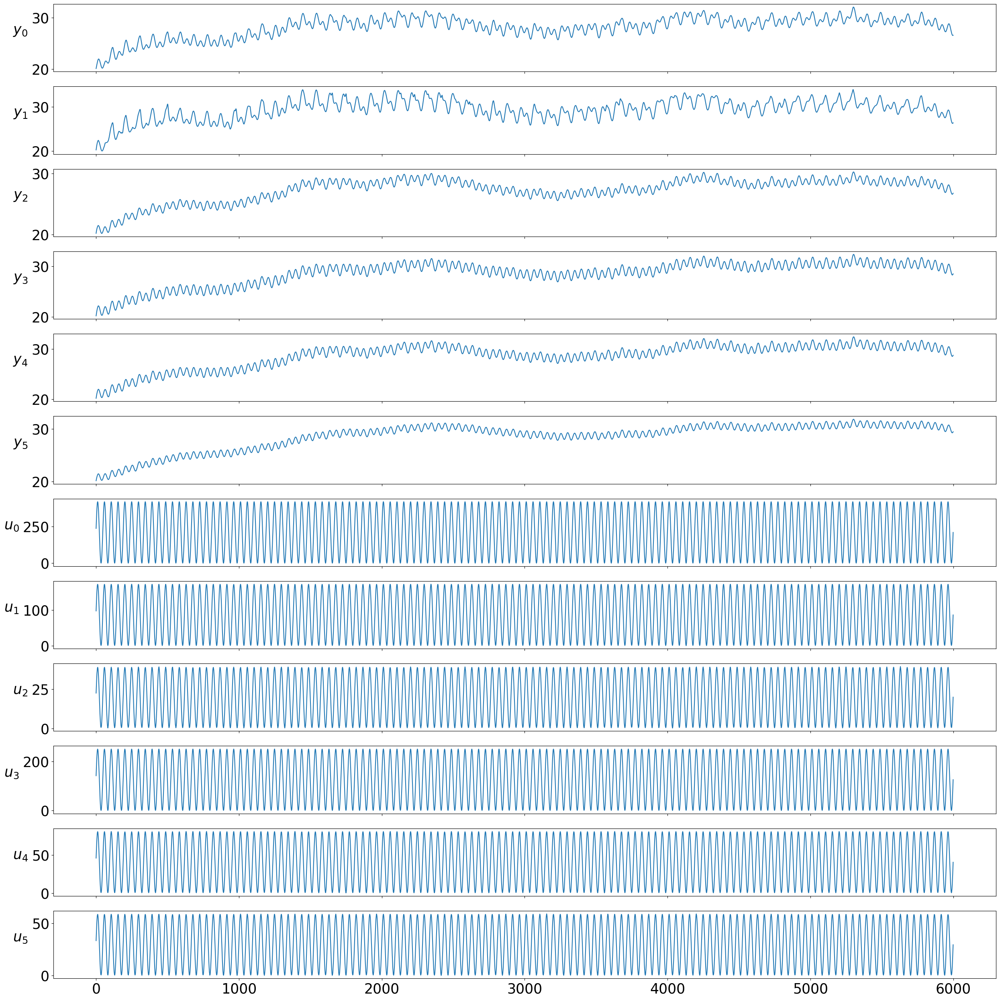

LinearRenoLight_ROM40


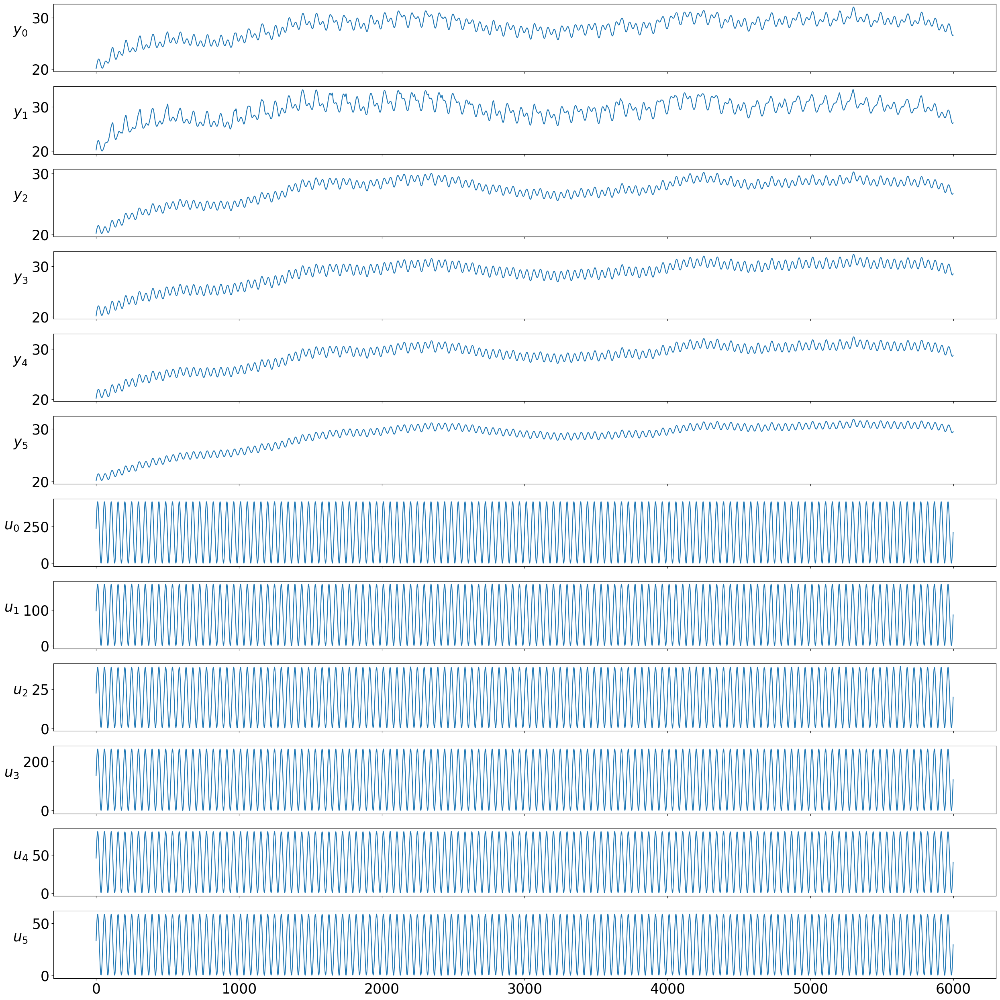

LinearOld_full


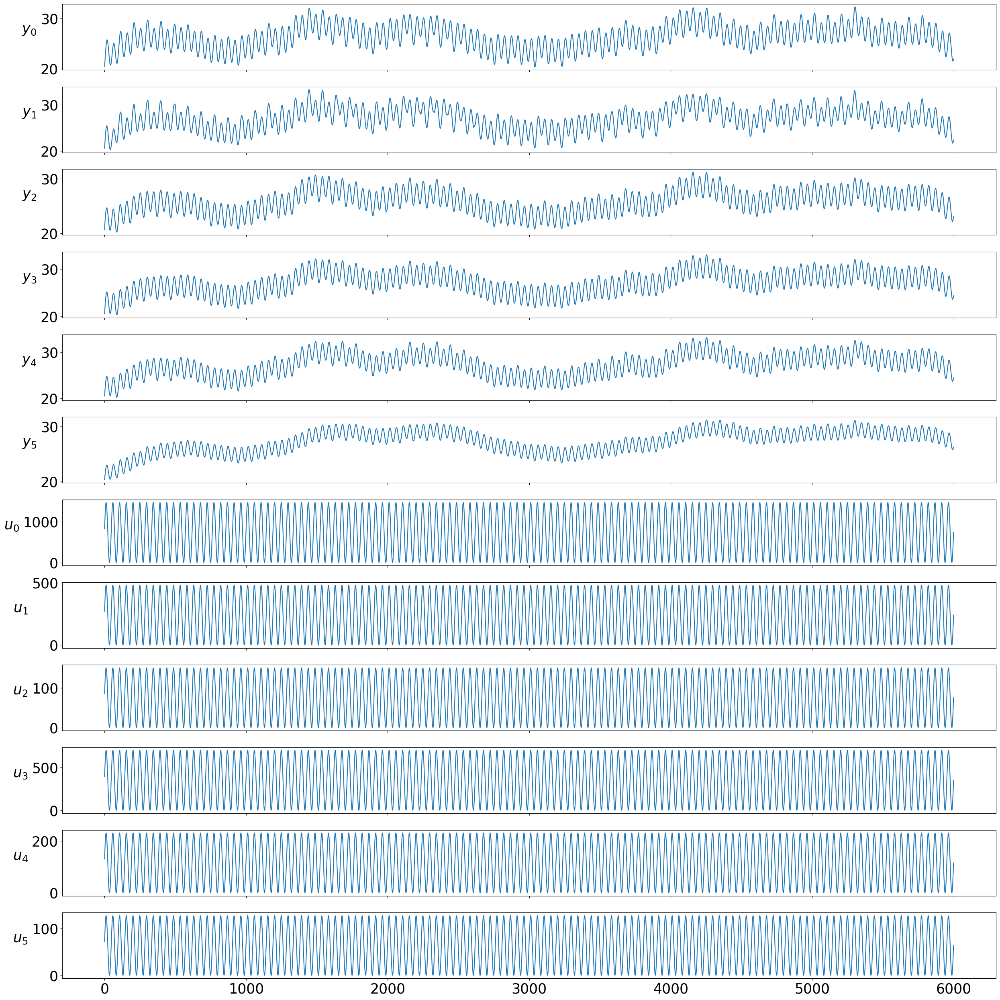

LinearOld_ROM40


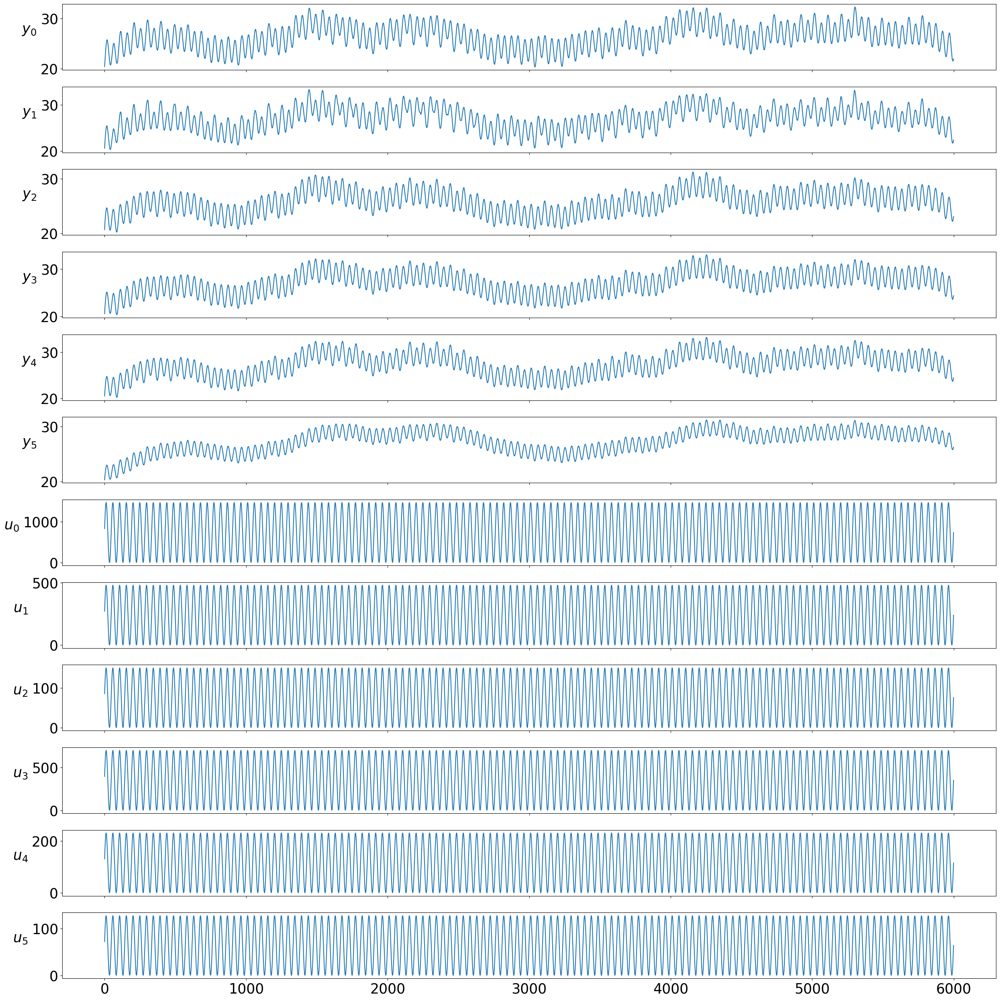

LinearHollandschHuys_full


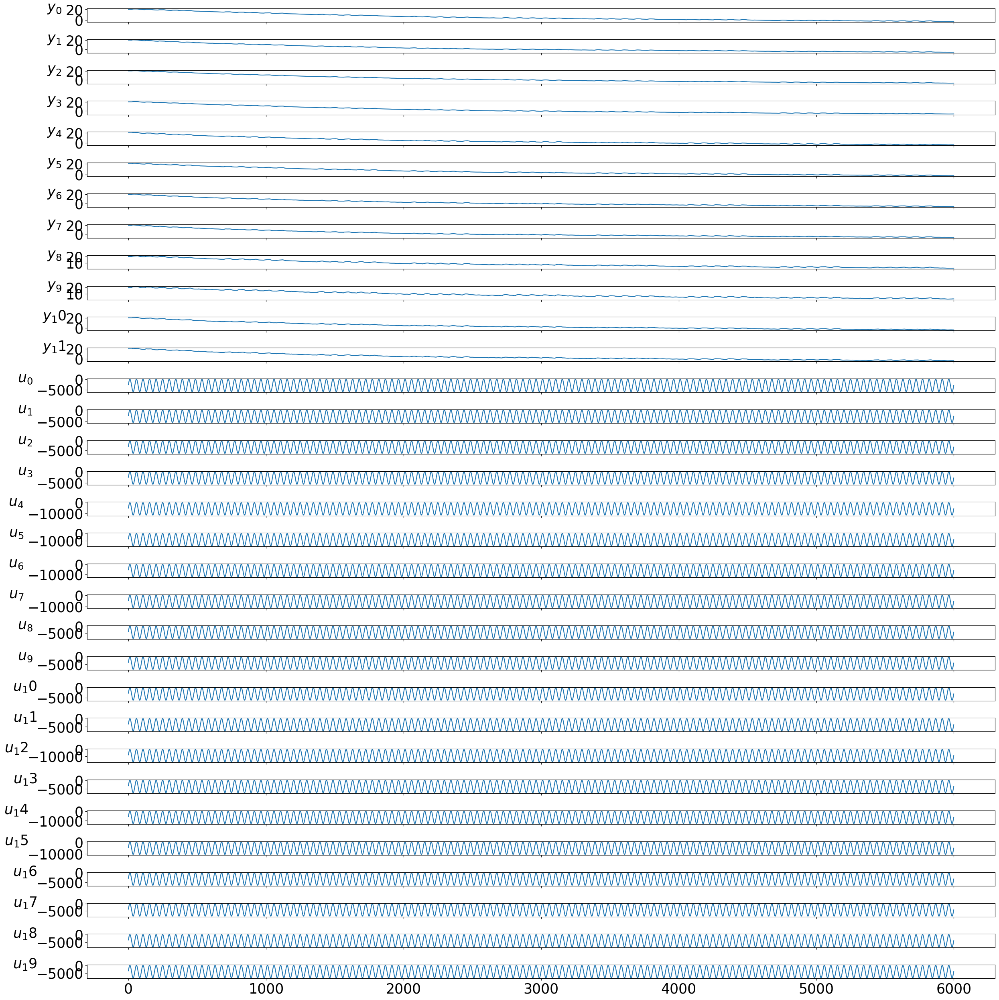

LinearHollandschHuys_ROM100


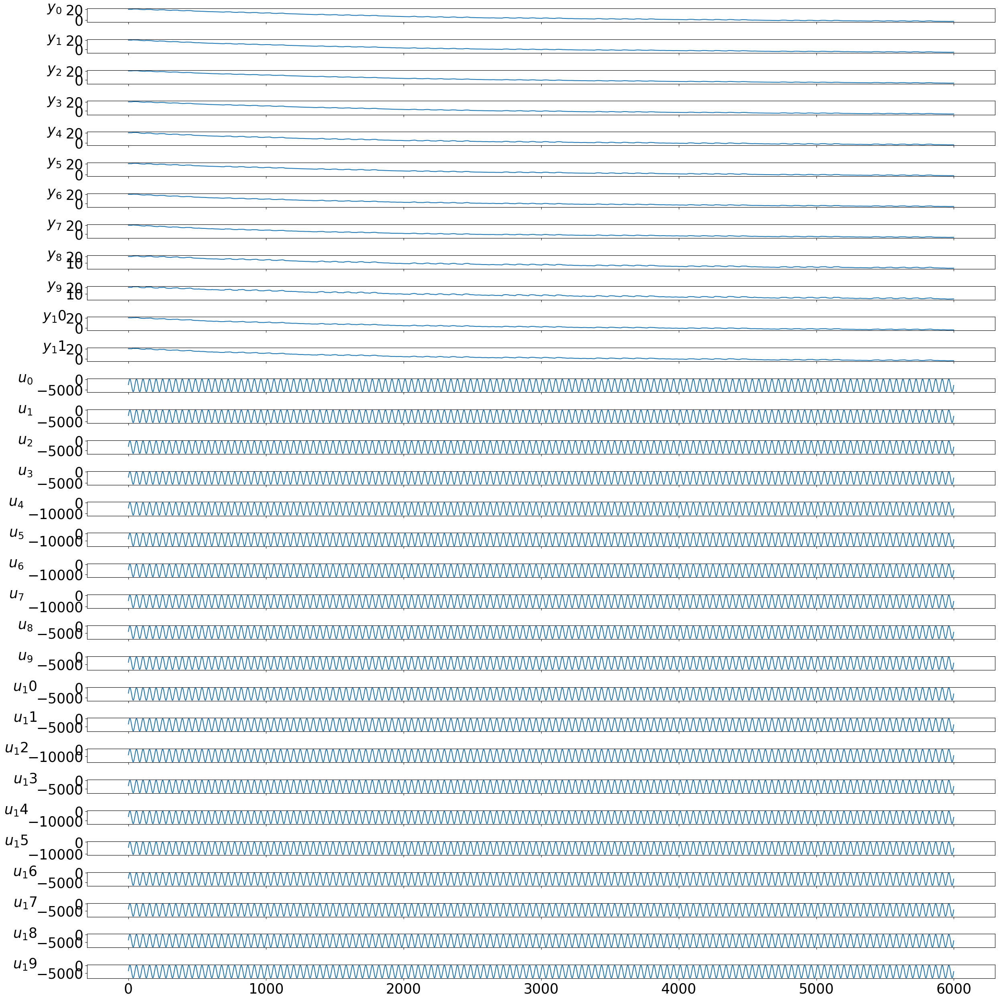

RCNet


AttributeError: 'RC_Network' object has no attribute 'stats_data'

In [5]:
for n, sys in neuromancer.psl.systems.items():
    print(n)
    sys().show()
    plt.close()

In [6]:
sys = neuromancer.psl.systems['CSTR']()
print(f'Changing inputs and states: {sys.variables}')
print(f'Constants defining simulation: {sys.constants}')
print(f'Parameters of the system: {sys._params}')
print(f'number of inputs: {sys.nu}')
print(f'state dimension: {sys.nx}')
import pprint
pprint.pprint(sys.stats)

Changing inputs and states: {'x0': [0.87725294608097, 324.475443431599], 'U': array([[300.5265 ],
       [300.5265 ],
       [300.5265 ],
       ...,
       [299.45392],
       [298.13162],
       [298.13162]], dtype=float32)}
Constants defining simulation: {'ts': 0.1, 'Ca_ss': 0.87725294608097, 'T_ss': 324.475443431599}
Parameters of the system: {'q': 100.0, 'V': 100.0, 'rho': 1000.0, 'Cp': 0.239, 'mdelH': 50000.0, 'EoverR': 8750.0, 'k0': 72000000000.0, 'UA': 50000.0, 'u_ss': 300.0, 'Tf': 350.0, 'Caf': 1.0}
number of inputs: 1
state dimension: 2
{'U': {'max': array([302.9421], dtype=float32),
       'mean': array([299.8687], dtype=float32),
       'min': array([297.0349], dtype=float32),
       'std': array([1.9711083], dtype=float32),
       'var': array([3.885268], dtype=float32)},
 'X': {'max': array([  0.91011167, 331.64575   ], dtype=float32),
       'mean': array([  0.8716909, 324.7645   ], dtype=float32),
       'min': array([  0.8033325, 320.15958  ], dtype=float32),
       's

# Defining an ODE based dynamical system in PSL

Consider the hamiltonian system on a plane defined by the ordinary differential equations: 

$$\dot{x_0} = x_1$$
$$\dot{x_1} = \frac{g}{l} \sin(x_0)$$

Let's define using PSL with $$g = -1, l = 1$$ to simulate an undamped pendulum with no driving force.

In [7]:
from neuromancer.psl.base import ODE_Autonomous, cast_backend
import numpy as np

class Hamiltonian(ODE_Autonomous):

    @property
    def params(self):
        variables = {'x0': [-2., 2.]} # Initial condition
        constants = {'ts': 0.1} # Time step for numerical simulation
        parameters = {'g': -1., # parameters of the hamiltonian system
                      'l': 1.}
        meta = {}
        return variables, constants, parameters, meta
        
    @cast_backend
    def equations(self, t, x):
        return [x[1], (self.g/self.l)*np.sin(x[0])]
    

Changing inputs and states: {'x0': [-2.0, 2.0]}
Constants defining simulation: {'ts': 0.1}
Parameters of the system: {'g': -1.0, 'l': 1.0}
state dimension: 2
{'X': {'max': array([210.65944  ,   2.6138647], dtype=float32),
       'mean': array([104.564415,   2.124309], dtype=float32),
       'min': array([-1.7953291,  1.6829406], dtype=float32),
       'std': array([61.34367  ,  0.3287906], dtype=float32),
       'var': array([3.7630459e+03, 1.0810326e-01], dtype=float32)},
 'Y': {'max': array([210.65944  ,   2.6138647], dtype=float32),
       'mean': array([104.564415,   2.124309], dtype=float32),
       'min': array([-1.7953291,  1.6829406], dtype=float32),
       'std': array([61.34367  ,  0.3287906], dtype=float32),
       'var': array([3.7630459e+03, 1.0810326e-01], dtype=float32)}}


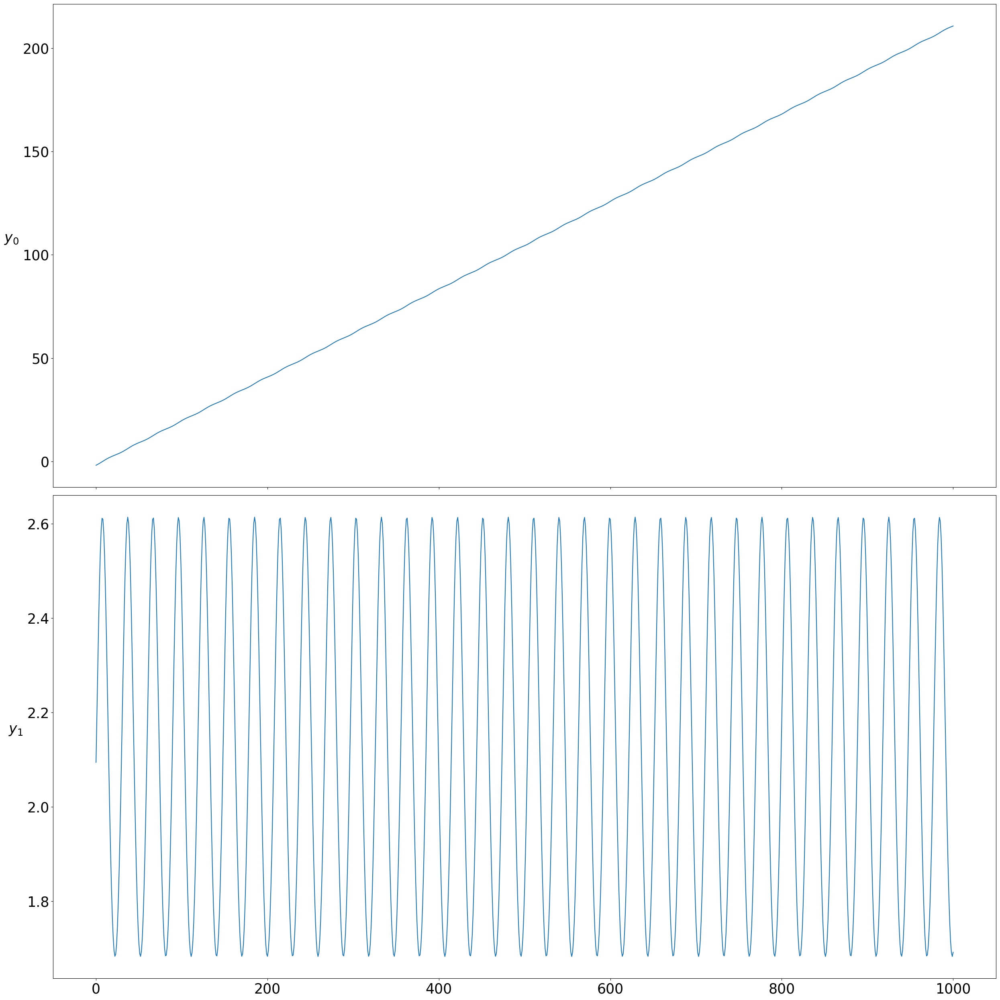

In [8]:
sys = Hamiltonian()
print(f'Changing inputs and states: {sys.variables}')
print(f'Constants defining simulation: {sys.constants}')
print(f'Parameters of the system: {sys._params}')
print(f'state dimension: {sys.nx}')
import pprint
pprint.pprint(sys.stats)
sys.show()
plt.close()

In [9]:
def plot_field(sys, xlim, ylim, scale=100, density=15j):
    X, Y = np.mgrid[xlim[0]:xlim[1]:density, ylim[0]:ylim[1]:density]
    print(X.shape, Y.shape)
    u, v = sys.equations(None, [X, Y])
    print(u.shape, v.shape)
    plt.quiver(X, Y, u, v, color='b', scale=scale)


(15, 15) (15, 15)
(15, 15) (15, 15)


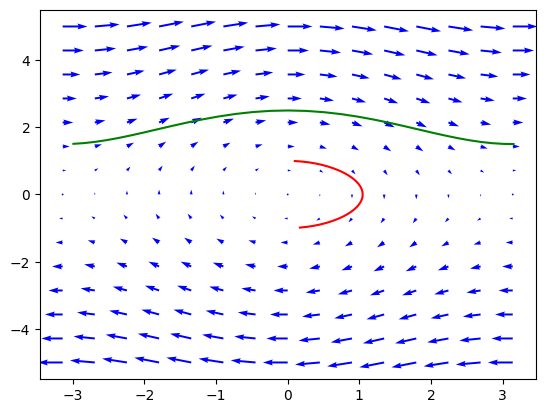

In [10]:
plot_field(Hamiltonian(), (-np.pi, np.pi), (-5, 5))
sys.ts = 0.1
data1 = sys.simulate(nsim=32, x0=np.array([0, 1]))
data2 = sys.simulate(nsim=32, x0=np.array([-np.pi, 1.5]))
plt.plot(data1['X'][:, 0], data1['X'][:, 1], c='r')
plt.plot(data2['X'][:, 0], data2['X'][:, 1], c='g')
# plt.xlim((-2*np.pi, 2*np.pi))

# Modeling a dynamical system from data with NODEs

Let's say we have measurements of this system from a sample of initial conditions simulated for 400 time-steps. How many uniformly sampled initial conditions does it take to learn a decent model of this system? 

(15, 15) (15, 15)
(15, 15) (15, 15)


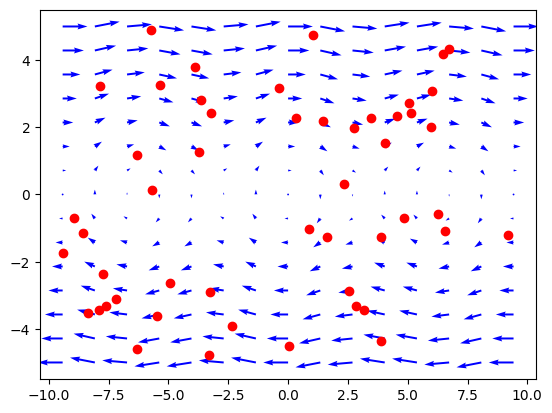

In [11]:
from neuromancer.system import Node, System
import torch
# Sample 50 initial conditions covering the range of system behavior. 
x0s = np.random.uniform(low=np.array([-3*np.pi, -5.]), high=np.array([3*np.pi, 5]), size=(50, 2))
plot_field(sys, (-3*np.pi, 3*np.pi), (-5, 5))
plt.scatter(x0s[:, 0], x0s[:, 1], c='r')


(15, 15) (15, 15)
(15, 15) (15, 15)


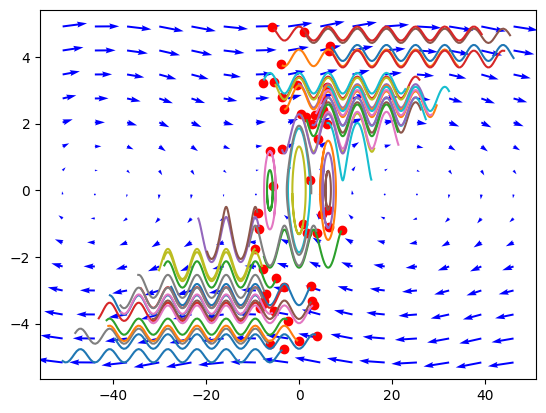

In [12]:
samples = [sys.simulate(nsim=96, x0=x0) for x0 in x0s]
X = np.concatenate([s['X'] for s in samples])
maxx, minx = X[:, 0].max(), X[:, 0].min()
maxy, miny = X[:, 1].max(), X[:, 1].min()

plot_field(sys, (minx, maxx), (miny, maxy))
for s in samples:
    plt.plot(s['X'][:, 0], s['X'][:, 1])
plt.scatter(x0s[:, 0], x0s[:, 1], c='r')


In [13]:
# Change the default system stats to statistics from our training set
pprint.pprint(sys.stats)
sys.set_stats(sim={'X': X})
pprint.pprint(sys.stats)

# Create a pytorch dataloader for use in training the system model
samples = {'X': torch.stack([torch.tensor(s['X'], dtype=torch.float32) for s in samples])}
samples = sys.normalize(samples)
samples['X'].shape, type(samples['X'])


{'X': {'max': array([210.65944  ,   2.6138647], dtype=float32),
       'mean': array([104.564415,   2.124309], dtype=float32),
       'min': array([-1.7953291,  1.6829406], dtype=float32),
       'std': array([61.34367  ,  0.3287906], dtype=float32),
       'var': array([3.7630459e+03, 1.0810326e-01], dtype=float32)},
 'Y': {'max': array([210.65944  ,   2.6138647], dtype=float32),
       'mean': array([104.564415,   2.124309], dtype=float32),
       'min': array([-1.7953291,  1.6829406], dtype=float32),
       'std': array([61.34367  ,  0.3287906], dtype=float32),
       'var': array([3.7630459e+03, 1.0810326e-01], dtype=float32)}}
{'X': {'max': array([46.249535,  4.914327], dtype=float32),
       'mean': array([-1.3784176 , -0.12262823], dtype=float32),
       'min': array([-50.95982  ,  -5.1638603], dtype=float32),
       'std': array([18.06911  ,  2.9034045], dtype=float32),
       'var': array([326.49274 ,   8.429758], dtype=float32)}}


(torch.Size([50, 96, 2]), torch.Tensor)

In [14]:
from neuromancer.dataset import DictDataset

# Make a function to generate data
def get_data(sys, xmin, xmax, nstep, nsamples, name='train'):
    
    # Sample initial conditions
    x0s = np.random.uniform(low=xmin, high=xmax, size=(nsamples, sys.nx))
    
    # Create nsamples simulations with sampled initial conditions
    samples = [sys.simulate(nsim=nstep, x0=x0) for x0 in x0s]
    
    # Calculate min and max for plotting axis bounds    
    X = np.concatenate([s['X'] for s in samples])
    maxx, minx = X[:, 0].max(), X[:, 0].min()
    maxy, miny = X[:, 1].max(), X[:, 1].min()

    # Plot vector field, initial conditions and samples
    plot_field(sys, (minx, maxx), (miny, maxy))
    for s in samples:
        plt.plot(s['X'][:, 0], s['X'][:, 1])
    plt.scatter(x0s[:, 0], x0s[:, 1], c='r')
    
    if name == 'train':
        # Change the default system stats to statistics from our training set
        pprint.pprint(sys.stats)
        sys.set_stats(sim={'X': X})
        pprint.pprint(sys.stats)

    # Create a pytorch dataloader
    samples = {'X': torch.stack([torch.tensor(s['X'], dtype=torch.float32) for s in samples])}
    
    samples = sys.normalize(samples)
    samples['xn'] = samples['X'][:, 0:1, :]
    data = DictDataset(samples, name=name)
    loader = torch.utils.data.DataLoader(data, num_workers=1, batch_size=50, collate_fn=data.collate_fn,
                                         shuffle=True)
    return loader

(15, 15) (15, 15)
(15, 15) (15, 15)
{'X': {'max': array([46.249535,  4.914327], dtype=float32),
       'mean': array([-1.3784176 , -0.12262823], dtype=float32),
       'min': array([-50.95982  ,  -5.1638603], dtype=float32),
       'std': array([18.06911  ,  2.9034045], dtype=float32),
       'var': array([326.49274 ,   8.429758], dtype=float32)}}
{'X': {'max': array([51.98787 ,  5.083249], dtype=float32),
       'mean': array([-1.3591757 , -0.25108474], dtype=float32),
       'min': array([-55.776352 ,  -5.3556767], dtype=float32),
       'std': array([19.12113 ,  3.186063], dtype=float32),
       'var': array([365.6176  ,  10.150997], dtype=float32)}}


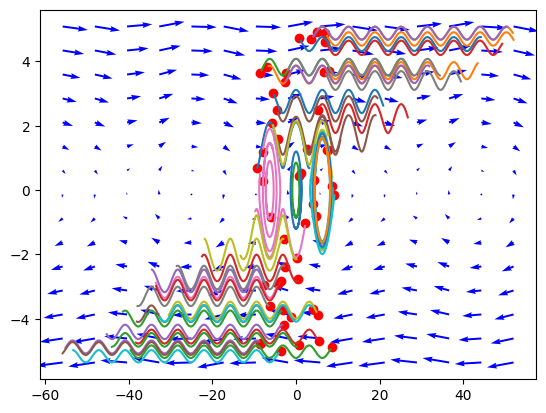

In [15]:
train_data = get_data(sys, np.array([-3*np.pi, -5.]), np.array([3*np.pi, 5]), 96, 50, name='train')

(15, 15) (15, 15)
(15, 15) (15, 15)


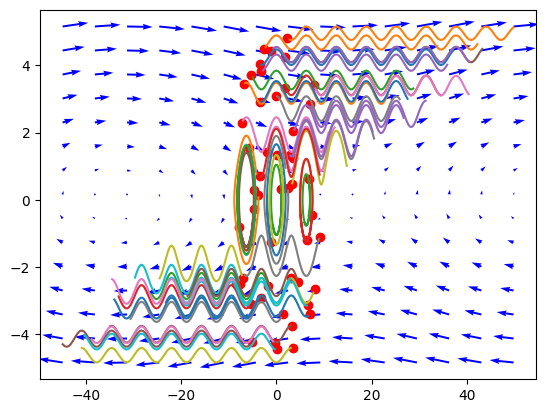

In [16]:
dev_data = get_data(sys, np.array([-3*np.pi, -5.]), np.array([3*np.pi, 5]), 96, 50, name='dev')

In [18]:
from neuromancer.system import Node
from neuromancer.modules.blocks import MLP
from neuromancer.dynamics.integrators import Euler
from neuromancer.modules.activations import SoftExponential

# linargs = {'sigma_min': .95, 'sigma_max': 1.05}
class MultipleShootingEulerIntegrator(torch.nn.Module):
    """
    Simple black-box NODE
    """
    def __init__(self, nx, hsize, nlayers, ts):
        super().__init__()
        self.dx = MLP(nx, nx, hsizes=[hsize for h in range(nlayers)], nonlin=SoftExponential)
        self.integrator = Euler(self.dx, h=torch.tensor(ts))

    def forward(self, x1, xn):
        """

        :param xn: (Tensor, shape=(batchsize, nx)) State
        :param u: (Tensor, shape=(batchsize, nu)) Control action
        :return: (Tensor, shape=(batchsize, nx)) xn+1
        """
        return self.integrator(x1), self.integrator(xn)

nx = 2
hsize = 64
nlayers = 3
integrator = MultipleShootingEulerIntegrator(nx, hsize, nlayers, sys.ts)
node = Node(integrator, ['X', 'xn'], ['xstep', 'xn'])
system = System([node])
# system.show()

In [19]:
from neuromancer.trainer import Trainer
from neuromancer.loggers import BasicLogger
from neuromancer.constraint import variable
from neuromancer.loss import PenaltyLoss
from neuromancer.problem import Problem

logger = BasicLogger(stdout=['train_objective_loss', 'dev_loss1', 'dev_loss2'], verbosity=1)
opt = torch.optim.AdamW(integrator.parameters(), 0.01)
xpred = variable('xn')[:, :-1, :]
xtrue = variable('X')
x1pred = variable('xstep')

loss1 = 0.1*(xpred == xtrue) ^ 2
loss1.update_name('loss1')
loss2 = (x1pred[:, :-1, :] == xtrue[:, 1:, :])^2
loss2.update_name('loss2')

obj = PenaltyLoss([loss1, loss2], [])
problem = Problem([system], obj)

trainer = Trainer(problem, train_data, dev_data, dev_data, opt, logger,
                  epochs=200,
                  patience=1000,
                  train_metric='train_objective_loss',
                  dev_metric='dev_loss',
                  test_metric='test_loss',
                  eval_metric='dev_loss')


None
Number of parameters: 8645


In [20]:
best_model = trainer.train()

epoch: 0	train_objective_loss: 0.14193	dev_loss1: 0.06856	dev_loss2: 0.00359	eltime:  17.16681
epoch: 1	train_objective_loss: 0.09321	dev_loss1: 0.06097	dev_loss2: 0.00611	eltime:  27.57931
epoch: 2	train_objective_loss: 0.08592	dev_loss1: 0.08053	dev_loss2: 0.00519	eltime:  37.80375
epoch: 3	train_objective_loss: 0.08767	dev_loss1: 0.03914	dev_loss2: 0.00238	eltime:  48.25741
epoch: 4	train_objective_loss: 0.05292	dev_loss1: 0.08049	dev_loss2: 0.00228	eltime:  59.19646
epoch: 5	train_objective_loss: 0.09718	dev_loss1: 0.06661	dev_loss2: 0.00539	eltime:  68.82061
epoch: 6	train_objective_loss: 0.09738	dev_loss1: 0.07201	dev_loss2: 0.01203	eltime:  78.37954
epoch: 7	train_objective_loss: 0.11324	dev_loss1: 0.07325	dev_loss2: 0.01972	eltime:  88.20021
epoch: 8	train_objective_loss: 0.12497	dev_loss1: 0.07354	dev_loss2: 0.02675	eltime:  97.82405
epoch: 9	train_objective_loss: 0.13440	dev_loss1: 0.07354	dev_loss2: 0.03200	eltime:  107.30621
epoch: 10	train_objective_loss: 0.14083	dev_loss1

epoch: 85	train_objective_loss: 0.11348	dev_loss1: 0.08061	dev_loss2: 0.01045	eltime:  953.71171
epoch: 86	train_objective_loss: 0.11321	dev_loss1: 0.08341	dev_loss2: 0.00968	eltime:  963.22667
epoch: 87	train_objective_loss: 0.11333	dev_loss1: 0.07880	dev_loss2: 0.00893	eltime:  972.74556
epoch: 88	train_objective_loss: 0.10879	dev_loss1: 0.07248	dev_loss2: 0.00825	eltime:  982.23952
epoch: 89	train_objective_loss: 0.10463	dev_loss1: 0.07100	dev_loss2: 0.00766	eltime:  991.87090
epoch: 90	train_objective_loss: 0.10470	dev_loss1: 0.06898	dev_loss2: 0.00703	eltime:  1001.48162
epoch: 91	train_objective_loss: 0.10066	dev_loss1: 0.06872	dev_loss2: 0.00641	eltime:  1011.52837
epoch: 92	train_objective_loss: 0.09442	dev_loss1: 0.07278	dev_loss2: 0.00586	eltime:  1022.34108
epoch: 93	train_objective_loss: 0.09263	dev_loss1: 0.05579	dev_loss2: 0.00520	eltime:  1033.62456
epoch: 94	train_objective_loss: 0.07690	dev_loss1: 0.04110	dev_loss2: 0.00465	eltime:  1044.77234
epoch: 95	train_objective

epoch: 168	train_objective_loss: 0.11446	dev_loss1: 0.06902	dev_loss2: 0.01830	eltime:  1782.46538
epoch: 169	train_objective_loss: 0.11305	dev_loss1: 0.06835	dev_loss2: 0.01761	eltime:  1792.23449
epoch: 170	train_objective_loss: 0.11185	dev_loss1: 0.06782	dev_loss2: 0.01696	eltime:  1802.11597
epoch: 171	train_objective_loss: 0.11079	dev_loss1: 0.06739	dev_loss2: 0.01635	eltime:  1812.03450
epoch: 172	train_objective_loss: 0.10979	dev_loss1: 0.06702	dev_loss2: 0.01576	eltime:  1821.92532
epoch: 173	train_objective_loss: 0.10880	dev_loss1: 0.06667	dev_loss2: 0.01519	eltime:  1831.79701
epoch: 174	train_objective_loss: 0.10775	dev_loss1: 0.06630	dev_loss2: 0.01462	eltime:  1841.48543
epoch: 175	train_objective_loss: 0.10661	dev_loss1: 0.06591	dev_loss2: 0.01407	eltime:  1851.07202
epoch: 176	train_objective_loss: 0.10535	dev_loss1: 0.06549	dev_loss2: 0.01352	eltime:  1860.78325
epoch: 177	train_objective_loss: 0.10395	dev_loss1: 0.06503	dev_loss2: 0.01297	eltime:  1870.45435
epoch: 178

(15, 15) (15, 15)
torch.Size([225, 2])
(15, 15) (15, 15)


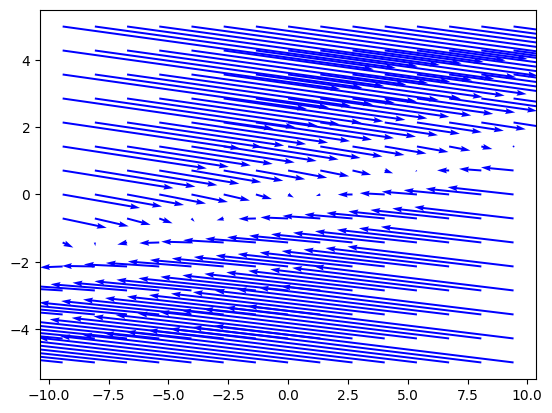

In [21]:
class rhs_wrapper:
    
    def __init__(self, dx, sys):
        self.dx = dx
        self.sys = sys
        
    def equations(self, t, X):
        X = torch.tensor(np.stack(X, axis=-1), dtype=torch.float32).reshape(-1, 2)
        print(X.shape)
        X = self.sys.normalize(X, key='X')
        output = self.dx(X)
        output = self.sys.denormalize(output, key='X')
        output = output.reshape(15, 15, 2).detach().numpy()
        return output[:, :, 0], output[:, :, 1]

problem.load_state_dict(best_model)
        
rhs = integrator.dx
func = rhs_wrapper(rhs, sys)
plot_field(func, (-3*np.pi, 3*np.pi), (-5, 5))

(15, 15) (15, 15)
(15, 15) (15, 15)


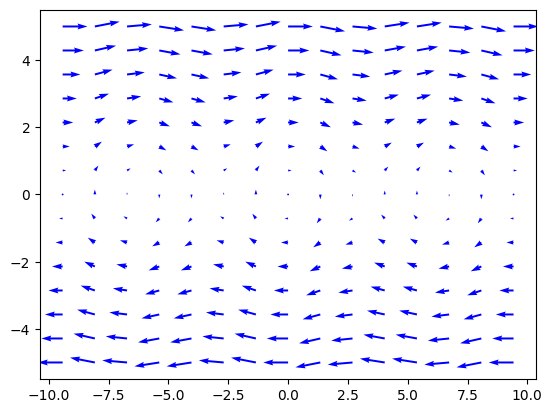

In [22]:
plot_field(sys, (-3*np.pi, 3*np.pi), (-5, 5))